In [18]:
import numpy as np
# import cv2
import tifffile as tiff
from shapely.geometry import Polygon, mapping, shape, box
from skimage import io
from skimage.measure import label, regionprops
import matplotlib.pyplot as plt
# import json
from rasterio import features
import scanpy as sc
import pandas as pd
import geopandas as gpd

from matplotlib import colors

import pickle
import scipy

import seaborn as sns

from SGanalysis.SGobject import SGobject 

import matplotlib
%matplotlib inline
# matplotlib.use('Qt5Agg')
# %matplotlib qt

from sklearn.cluster import AgglomerativeClustering as AggCluster

import sys
import os

%load_ext autoreload
%autoreload 2

tools_path  = '/Users/grantkinsler/Documents/Penn/Research/SpatialBarcodes/analysis/tools/tools.py'
sys.path.append(os.path.dirname(os.path.expanduser(tools_path)))
import tools

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
# filepath  = '/Users/grantkinsler/RajLab Dropbox/Grant Kinsler/Shared_Grant/SpatialBarcodes/ImagingData/2024-02-27_spatialbarcodes_SG_expression/projects/2024-02-27_spatialbarcodes_expression/'
filepath = '/Users/grantkinsler/RajLab Dropbox/Grant Kinsler/SpatialBarcodes/ImagingData/2024-05-21_mouseexp_expression/projects/'

# roi_2
roi_name = 'roi_2'


# /roi_2

In [3]:
# locations = pd.read_csv(f'{filepath}{roi_name}/exports/cell_attributes_cell_10px_20240605.csv',index_col=0)
# matrix = pd.read_csv(f'{filepath}{roi_name}/exports/cell_by_gene_matrix_20240606_10px_cell.csv',index_col=0)

# matrix.set_index(matrix.index.astype(str),inplace=True)
# locations.set_index(matrix.index.astype(str),inplace=True)

# /Volumes/GRK_001/spatialbarcodes/2024-05-21_mouseexp_expression/projects/roi2/exports/
with open(f'{filepath}{roi_name}/exports/sg_object_20240604_dilate10.pkl', 'rb') as f:
    sg_obj = pickle.load(f)


In [4]:
# set object id (as string) as index

matrix = sg_obj.get_cell_gene_table_df()
matrix['object_id'] = [str(int(x)) for x in matrix['object_id']]
matrix.set_index('object_id',inplace=True)

sg_obj.gdf['object_id'] = [str(int(x)) for x in sg_obj.gdf['object_id']]
sg_obj.gdf.set_index('object_id',inplace=True)

No filtering available or applied.


In [5]:
sg_obj.gdf['nucleus_centroid'] = sg_obj.gdf['nucleus'].centroid.values
sg_obj.gdf['center_x'] = sg_obj.gdf['nucleus'].centroid.x.values
sg_obj.gdf['center_y'] = sg_obj.gdf['nucleus'].centroid.y.values
sg_obj.gdf['area'] = sg_obj.gdf['nucleus_dilated'].area.values

In [6]:
barcode_cols = ['bc_{:03d}'.format(i) for i in range(1,97)]

In [7]:
cutoff = 4

cell_barcodes = {}
# matrix.set_index('object_id',   inplace=True)
# df.set_index('object_id')

df = matrix

# df.sort_index(inplace=True)

df['cell_id'] = df.index

for cell_id in df['cell_id']:
    this_cell = df[df['cell_id']==cell_id]
    cell_barcodes[cell_id] = []

    for bc in barcode_cols:
        if this_cell[bc].values[0] > cutoff:
            cell_barcodes[cell_id].append(bc)

df['called_barcodes'] = cell_barcodes.values()
df['n_called_barcodes'] = [len(bc_set) for bc_set in cell_barcodes.values()]
df['barcode_names'] = ['-'.join(sorted(bc_set)) for bc_set in cell_barcodes.values()]

df = pd.merge(df,sg_obj.gdf,how='left',left_index=True,right_index=True)


In [8]:
gene_cols = [col for col in df.columns if 'bc_' not in col and col not in ['cell_id','called_barcodes','n_called_barcodes','barcode_names','area','center_x','center_y','nucleus','nucleus_centroid','nucleus_dilated']]    

In [9]:
adata_genes = sc.AnnData(df[gene_cols])

cols= ['cell_id','n_called_barcodes','barcode_names','called_barcodes','area','center_x','center_y']
# for col in :
#     adata_genes.obs[col] = df[col]

adata_genes.obs = df[cols]

In [10]:
min_area = 2000

adata_genes = adata_genes[adata_genes.obs['area']>min_area]

In [11]:
# filter cells and genes by number of occurences 
sc.pp.filter_cells(adata_genes, min_genes=15) # keep only cells that have at least 10 genes
sc.pp.filter_genes(adata_genes, min_cells=500) # keep only genes that are expressed in at least 500 cells

/Users/grantkinsler/miniforge3/envs/spatialgenomics-env2/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:140: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_genes'] = number


In [12]:
min_number_barcodes = 1

name,count = np.unique(adata_genes.obs[adata_genes.obs['n_called_barcodes']>=min_number_barcodes]['barcode_names'].values,return_counts=True)

common_bc_combos = {}

min_number_cells = 10

for n,c in zip(name,count):
    if c > min_number_cells:
        # print(n,c)
        common_bc_combos[n] = c
    # print(n,c)  


(-648.8675447522292, 59258.76371243313, -771.1445560851262, 48869.84452242345)

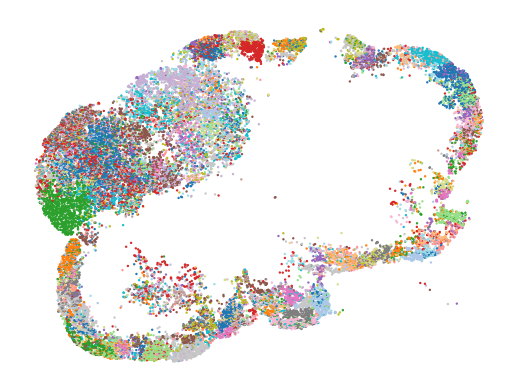

In [13]:
bc_colors = sns.color_palette('tab20',n_colors=len(common_bc_combos))
bc_color_dict = {bc:bc_colors[i] for i,bc in enumerate(common_bc_combos.keys())}

bc_color_list = [colors.to_rgba(bc_color_dict[bc],alpha=1.0) if bc in bc_color_dict.keys() else colors.to_rgba('gray',alpha=0.0)  for bc in adata_genes.obs['barcode_names'] ]

plt.scatter(adata_genes.obs['center_x'],adata_genes.obs['center_y'],marker='o',
            c=bc_color_list,
            s=0.5)


plt.axis('off')

In [14]:
# top 16 barcodes:
min_number_barcodes = 3
name,count = np.unique(adata_genes.obs[adata_genes.obs['n_called_barcodes']>=min_number_barcodes]['barcode_names'].values,return_counts=True)

very_common_bcs = name[np.argsort(count)[::-1][:16]]

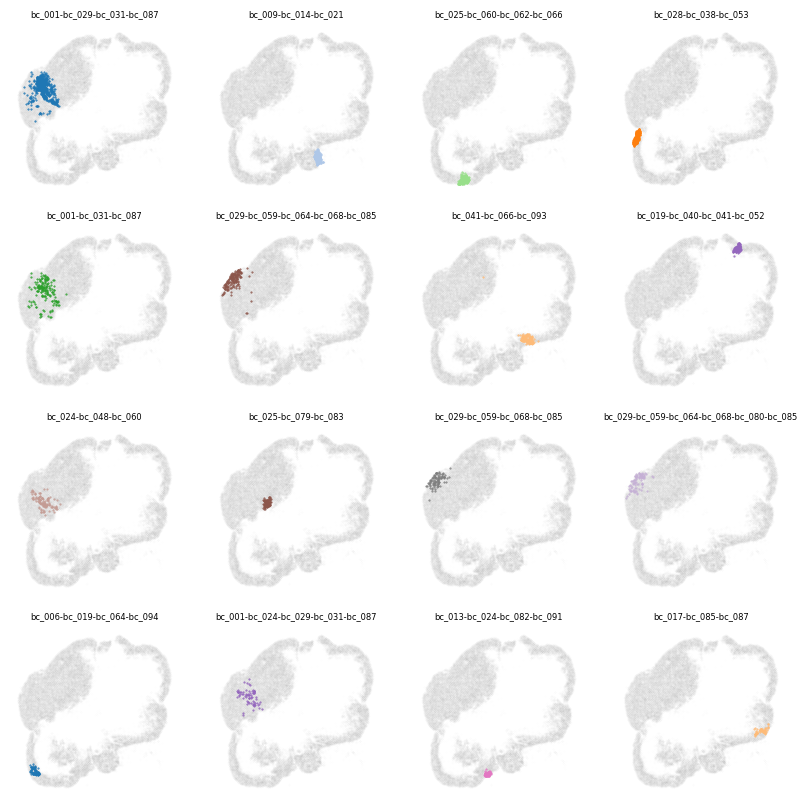

In [17]:
# very_common_bcs = ['bc_001-bc_024-bc_029-bc_031-bc_087',
#  'bc_001-bc_029-bc_031-bc_087',
#  'bc_007-bc_025-bc_027',
#  'bc_009-bc_014-bc_021',
#  'bc_009-bc_020-bc_091',
#  'bc_017-bc_085-bc_087',
#  'bc_019-bc_040-bc_041-bc_052',
#  'bc_024-bc_048-bc_060',
#  'bc_025-bc_060-bc_062-bc_066',
#  'bc_028-bc_038-bc_053',
#  'bc_029-bc_032-bc_059-bc_064-bc_068-bc_080-bc_085',
#  'bc_029-bc_059-bc_064-bc_068-bc_080-bc_085',
#  'bc_029-bc_059-bc_064-bc_068-bc_085',
#  'bc_041-bc_066-bc_080-bc_093',
#  'bc_041-bc_066-bc_093',
#  'bc_050-bc_065-bc_089']

plt.figure(figsize=(10,10))
for i,bc_name in enumerate(very_common_bcs):
    
    plt.subplot(4,4,i+1)
    plt.title(bc_name,fontsize=6)

    others = adata_genes[adata_genes.obs['barcode_names']!=bc_name]
    plt.scatter(others.obs['center_x'],others.obs['center_y'],marker='o',
            color='gray',alpha=0.01,
            s=0.1)

    this_bc = adata_genes[adata_genes.obs['barcode_names']==bc_name]

    plt.scatter(this_bc.obs['center_x'],this_bc.obs['center_y'],marker='o',
            color=bc_color_dict[bc_name],alpha=1.0,
            s=0.25)
    
    plt.axis('off')
    

In [15]:
def get_polygons_around_polygon(sg_obj,identifier,id_field='object_id',image_scale=5):

    polygon_gdf = sg_obj.gdf[sg_obj.gdf[id_field] == identifier]

    first_polygon_geometry = polygon_gdf.geometry.iloc[0]

    minx, miny, maxx, maxy = first_polygon_geometry.bounds
    dx = (maxx - minx) * 0.5 * image_scale
    dy = (maxy - miny) * 0.5 * image_scale
    expanded_bbox = box(minx - dx, miny - dy, maxx + dx, maxy + dy)

    other_polygons = sg_obj.gdf[sg_obj.gdf.geometry.intersects(expanded_bbox) & (sg_obj.gdf[id_field] != identifier)]

    return other_polygons

def get_polygon_barcodes(df,identifier,id_field='cell_id'):

    if len(df[df[id_field]==identifier]['called_barcodes'].values) > 0:

        return df[df[id_field]==identifier]['called_barcodes'].values[0]

    else:
        return []

def get_all_barcodes_in_region(df,identifiers,id_field='cell_id'):

    bc_list = []

    for identifier in identifiers:
        bc_list += get_polygon_barcodes(df,identifier,id_field=id_field)

    return bc_list



In [19]:
adata_genes.obs[adata_genes.obs['barcode_names'].isin([
    'bc_001-bc_031-bc_087'])]

,cell_id,n_called_barcodes,barcode_names,called_barcodes,area,center_x,center_y,n_genes
object_id,,,,,,,,
28744,28744,3,bc_001-bc_031-bc_087,"[bc_001, bc_031, bc_087]",13542.025793,14045.250669,21895.060037,39
28777,28777,3,bc_001-bc_031-bc_087,"[bc_001, bc_031, bc_087]",15006.433884,10096.414233,21919.880746,36
28915,28915,3,bc_001-bc_031-bc_087,"[bc_001, bc_031, bc_087]",4030.005009,13687.810861,21984.613598,28
29294,29294,3,bc_001-bc_031-bc_087,"[bc_001, bc_031, bc_087]",7293.435413,12769.623887,22252.881076,37
29299,29299,3,bc_001-bc_031-bc_087,"[bc_001, bc_031, bc_087]",8890.173668,10303.832481,22270.316703,35
...,...,...,...,...,...,...,...,...
49159,49159,3,bc_001-bc_031-bc_087,"[bc_001, bc_031, bc_087]",10855.107697,11788.747493,34079.469590,42
49458,49458,3,bc_001-bc_031-bc_087,"[bc_001, bc_031, bc_087]",6695.849883,10957.819541,34228.728733,36
49513,49513,3,bc_001-bc_031-bc_087,"[bc_001, bc_031, bc_087]",14968.656408,11642.138205,34271.282875,52


In [61]:
sg_obj.gdf['object_id'] = sg_obj.gdf.index

In [21]:
image_prefix = '/Users/grantkinsler/RajLab Dropbox/Grant Kinsler/Shared_Grant/SpatialBarcodes/ImagingData/2024-05-21_mouseexp_expression/2024-05-21_spatialbarcodes_tumor_expression'

image_path = f'{image_prefix}/{roi_name}/hyb_background_aligned.tiff'

image_path = '/Users/grantkinsler/RajLab Dropbox/Grant Kinsler/SpatialBarcodes/ImagingData/2024-05-21_mouseexp_expression/2024-05-21_spatialbarcodes_tumor_expression/roi_2/hyb_background_aligned.tiff'

In [38]:
tools.show_neighberhood(sg_obj,'28744',image_path=image_path,image_scale=2)

: 

In [1]:
print('hi')

hi


13542.025792985334


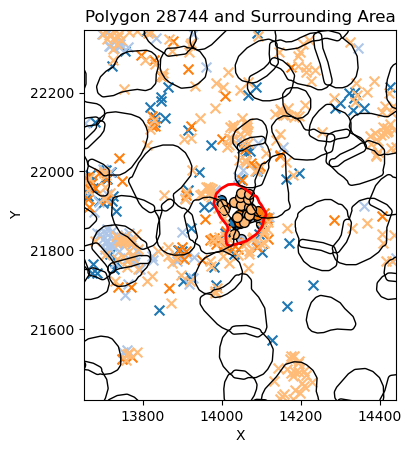

7293.435412661803


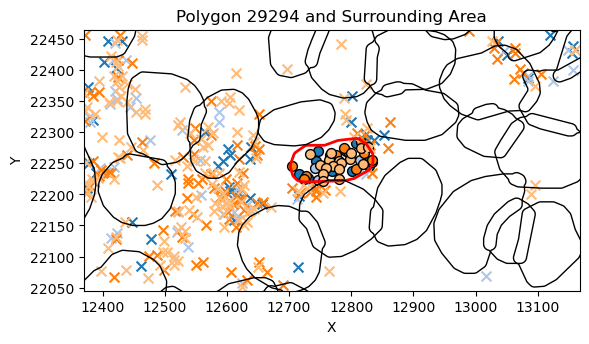

10855.107696690393


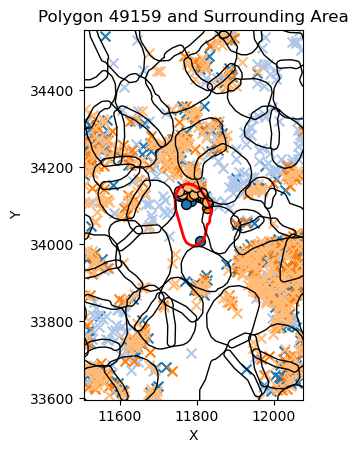

7401.183042984318


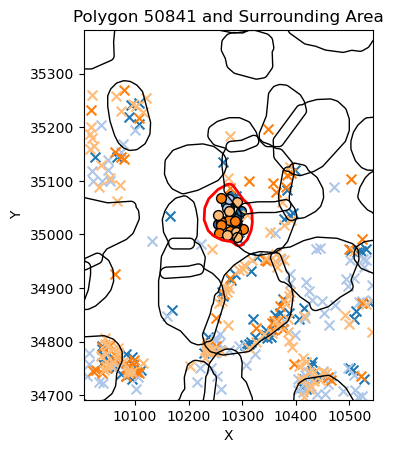

In [21]:
for cell_id in ['28744','29294','49159','50841']:
    # print(cell_id,mapping_dict[cell_id],df[df['cell_id']==cell_id]['called_barcodes'].values[0])

    # print(df[df['cell_id']==cell_id]['area'].values[0])
    # print(adata_genes.obs.loc[cell_id]['total_counts']) 

    print(df[df['cell_id']==cell_id]['area'].values[0])

    # region = get_polygons_around_polygon(sg_obj,cell_id,image_scale=10)

    # gene_names = [    'bc_001','bc_029','bc_031','bc_087']

    # gene_names = ['bc_029']
    gene_names = ['bc_001','bc_029','bc_031','bc_087']


    # gene_names = ['bc_024']
        # 'bc_001','bc_029','bc_031','bc_087'



    # gene_names = get_all_barcodes_in_region(df,region['object_id'].values)
    # gene_names.append('SOX10')

    # print(gene_names)

    # gene_names = df[df['cell_id']==cell_id]['called_barcodes'].values[0] + df[df['cell_id']=='60']['called_barcodes'].values[0]

    sg_obj.plot_polygon_and_points(cell_id,gene_names=gene_names,annotate=False,image_scale=5)
    # sg_obj_only_bcs.plot_polygon_and_points(mapping_dict[cell_id],gene_names=gene_names,annotate=False)

In [16]:
min_number_barcodes = 1

name,count = np.unique(adata_genes.obs[adata_genes.obs['n_called_barcodes']>=min_number_barcodes]['barcode_names'].values,return_counts=True)

common_bc_combos = {}

min_number_cells = 10

for n,c in zip(name,count):
    if c > min_number_cells:
        # print(n,c)
        common_bc_combos[n] = c
    # print(n,c)  


In [17]:
common_bc_combos.keys()

dict_keys(['bc_001', 'bc_001-bc_003-bc_014-bc_033-bc_060-bc_076-bc_094', 'bc_001-bc_004-bc_041', 'bc_001-bc_005-bc_025-bc_030', 'bc_001-bc_013-bc_089', 'bc_001-bc_019', 'bc_001-bc_019-bc_064', 'bc_001-bc_020', 'bc_001-bc_024-bc_029-bc_031-bc_087', 'bc_001-bc_024-bc_031-bc_087', 'bc_001-bc_024-bc_087', 'bc_001-bc_025', 'bc_001-bc_025-bc_030', 'bc_001-bc_025-bc_040', 'bc_001-bc_027', 'bc_001-bc_029-bc_031', 'bc_001-bc_029-bc_031-bc_048-bc_060-bc_087', 'bc_001-bc_029-bc_031-bc_048-bc_087', 'bc_001-bc_029-bc_031-bc_059-bc_085-bc_087', 'bc_001-bc_029-bc_031-bc_085-bc_087', 'bc_001-bc_029-bc_031-bc_087', 'bc_001-bc_029-bc_087', 'bc_001-bc_030', 'bc_001-bc_031', 'bc_001-bc_031-bc_087', 'bc_001-bc_041', 'bc_001-bc_048-bc_060-bc_087', 'bc_001-bc_060', 'bc_001-bc_064', 'bc_001-bc_087', 'bc_002', 'bc_002-bc_033', 'bc_002-bc_094', 'bc_003', 'bc_003-bc_066', 'bc_004', 'bc_004-bc_007-bc_059', 'bc_004-bc_013-bc_048-bc_066-bc_083', 'bc_004-bc_024', 'bc_004-bc_024-bc_041', 'bc_004-bc_024-bc_041-bc_077'

In [18]:
string_rep = {}

for key in common_bc_combos.keys():
    print(key)
    s = "0"*96
    numbers = [int(v[4:])-1 for v in key.split('-')]
    for n in numbers:
        s = s[:n] + '1' + s[n+1:]
    print(s)
    string_rep[key] = s

string_rep_list = [string_rep[key] for key in string_rep.keys()]    

    

bc_001
100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
bc_001-bc_003-bc_014-bc_033-bc_060-bc_076-bc_094
101000000000010000000000000000001000000000000000000000000001000000000000000100000000000000000100
bc_001-bc_004-bc_041
100100000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000
bc_001-bc_005-bc_025-bc_030
100010000000000000000000100001000000000000000000000000000000000000000000000000000000000000000000
bc_001-bc_013-bc_089
100000000000100000000000000000000000000000000000000000000000000000000000000000000000000010000000
bc_001-bc_019
100000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000
bc_001-bc_019-bc_064
100000000000000000100000000000000000000000000000000000000000000100000000000000000000000000000000
bc_001-bc_020
100000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000
bc_001-bc_024-bc_029-bc_031-bc_087
10000000000000

[['1',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['1',
  '0',
  '1',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '1',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '1',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'

In [37]:
pdist = scipy.spatial.distance.pdist([list(x) for x in string_rep_list],'hamming')
pdist = pdist * 96

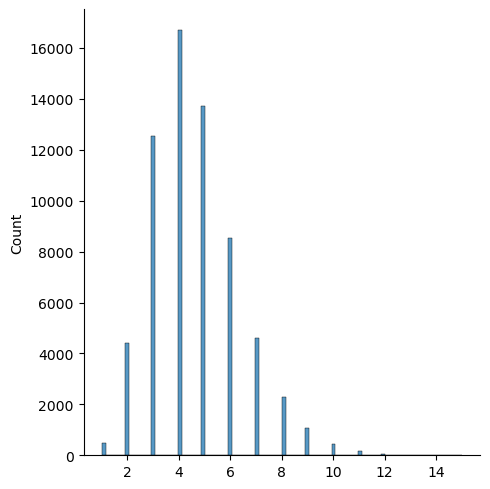

In [39]:
sns.displot(pdist)

In [ ]:
np.where(pdist)

In [56]:
scipy.spatial.distance.hamming(list(string_rep['bc_001-bc_031-bc_087']),list(string_rep['bc_001']))*96

2.0

In [19]:
len(df[barcode_cols])

67202

In [67]:
has_bcs = df[~np.all(df[barcode_cols].values==0,axis=1)]

random_indices = np.random.choice(range(len(has_bcs[barcode_cols])),size=1000,replace=False)

In [68]:
random_matrix = has_bcs[barcode_cols].iloc[random_indices]

braycurtis_dist = scipy.spatial.distance.pdist(random_matrix,metric='braycurtis')

In [69]:
random_matrix = df[barcode_cols].iloc[random_indices]

In [70]:
braycurtis_dist_square = scipy.spatial.distance.squareform(braycurtis_dist)

In [71]:
braycurtis_dist_square.shape

(1000, 1000)

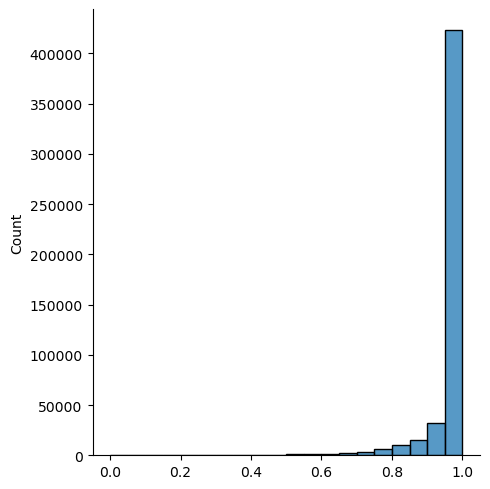

In [72]:
sns.displot(braycurtis_dist)

In [102]:
cluster = AggCluster(distance_threshold=10,n_clusters=None,linkage='complete',affinity='precomputed').fit(braycurtis_dist_square)

In [103]:
from scipy.cluster.hierarchy import dendrogram

In [105]:
# matplotlib.use('Qt5Agg')
# %matplotlib qt

In [22]:
plt.figure(figsize=(30,2))

# labels_here = [l if l.count('_') > 2 else '' for l in has_bcs['barcode_names'].values[random_indices]]
# plot_dendrogram(cluster,labels=has_bcs['barcode_names'].values[random_indices],leaf_rotation=90,leaf_font_size=6)
tools.plot_dendrogram(cluster,leaf_rotation=90,leaf_font_size=6)

NameError: name 'dendrogram' is not defined

<Figure size 3000x200 with 0 Axes>

In [111]:
names_here = has_bcs['barcode_names'].values[random_indices]
cells_here = has_bcs['cell_id'].values[random_indices]

In [113]:
cells_here

array(['42947', '50480', '55262', '61306', '66905', '41445', '41647',
       '40167', '15762', '49601', '56595', '27704', '13668', '26625',
       '43332', '66673', '21298', '13456', '42232', '66384', '38044',
       '33453', '22233', '34092', '32707', '13881', '45001', '49816',
       '51673', '62977', '54800', '35555', '6517', '62689', '49612',
       '31544', '57257', '65861', '44286', '30010', '43162', '11888',
       '56012', '58804', '62270', '52532', '26148', '34950', '11074',
       '34234', '54678', '59715', '40489', '52137', '26872', '56868',
       '62633', '21574', '27321', '50295', '53921', '3920', '12817',
       '9990', '37271', '1432', '49317', '33139', '31451', '47023',
       '48501', '34812', '61597', '1190', '48956', '63769', '61918',
       '25147', '16287', '27461', '37496', '33711', '53754', '36042',
       '11281', '50055', '42068', '4812', '37600', '29720', '2589',
       '19544', '48846', '838', '14436', '13903', '44900', '15356',
       '64794', '6967', '3400

In [114]:
np.where(names_here=='bc_001-bc_029-bc_031-bc_087')

(array([ 83, 105, 215, 354, 391, 418, 560, 574, 610, 620, 650, 988]),)

Text(0.5, 0, 'Bray-Curtis Dissimiliarity')

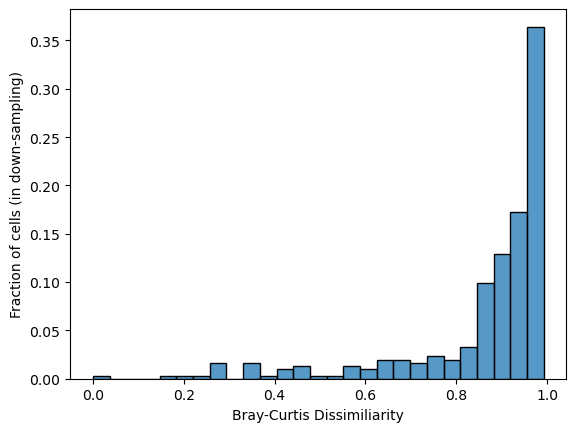

In [161]:
ix = np.where(braycurtis_dist_square[83,:] < 1)
sns.histplot(braycurtis_dist_square[83,:][ix],stat='probability')

plt.ylabel('Fraction of cells (in down-sampling)')
plt.xlabel('Bray-Curtis Dissimiliarity')

In [154]:
ix = np.where(braycurtis_dist_square[83,:] < 0.75)

[(z,x,y) for z,x,y in zip(cells_here[ix],names_here[ix ],braycurtis_dist_square[83,ix][0])]

cell_ids_to_check = cells_here[ix]

43332 bc_029-bc_087 0.6538461538461539


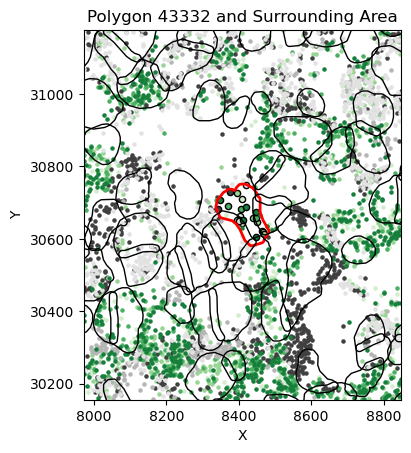

47023 bc_001-bc_031-bc_087 0.4642857142857143


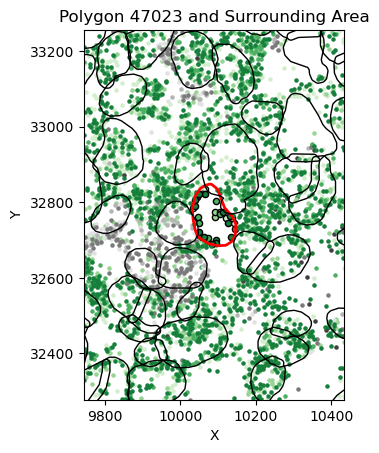

34812 bc_067-bc_077-bc_087 0.7384615384615385


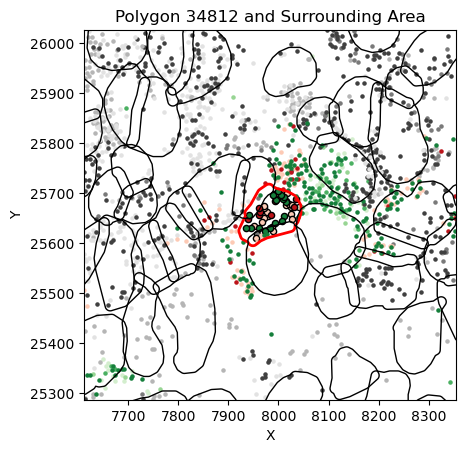

36042 bc_001-bc_029-bc_031-bc_087 0.0


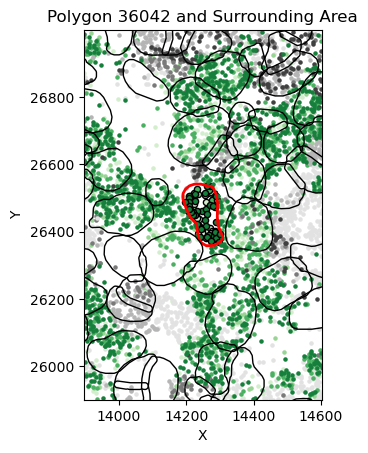

44900 bc_087 0.5


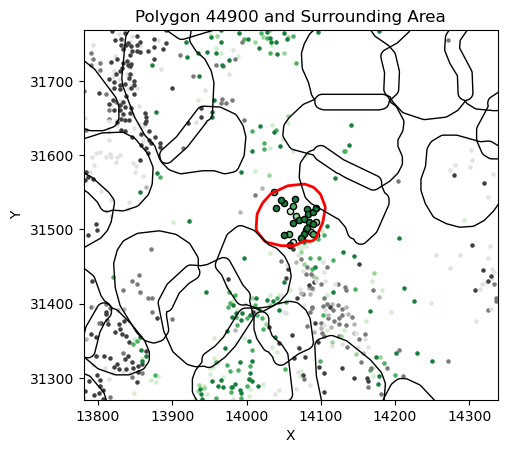

42702 bc_001-bc_029-bc_031-bc_087 0.2835820895522388


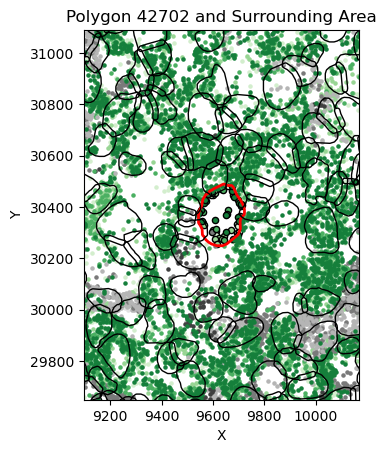

60284 bc_001-bc_064 0.5675675675675675


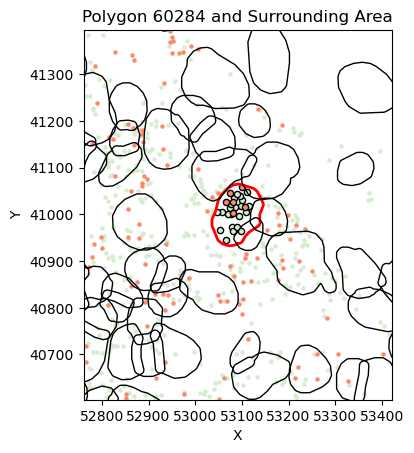

60934 bc_001-bc_064 0.7373737373737373


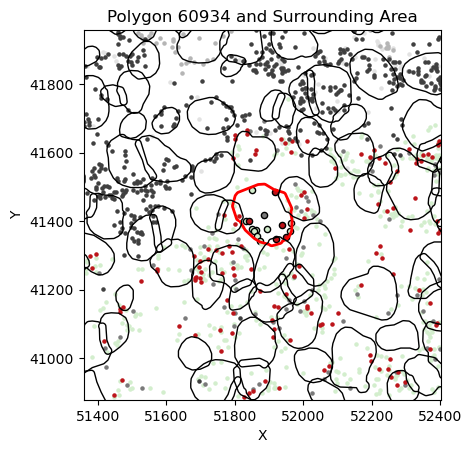

33106 bc_087 0.7391304347826086


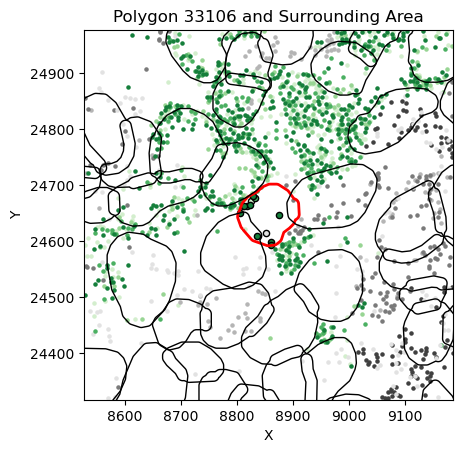

46265 bc_001-bc_029-bc_031-bc_087 0.16470588235294117


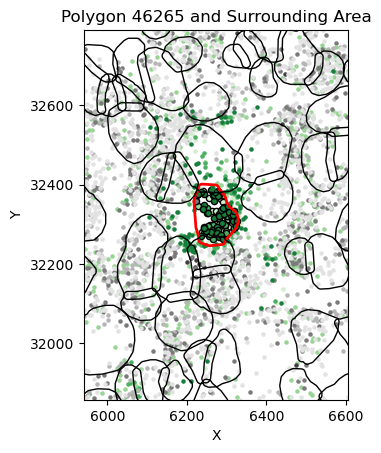

45497 bc_001-bc_002-bc_029-bc_031-bc_068-bc_085-bc_087 0.4157303370786517


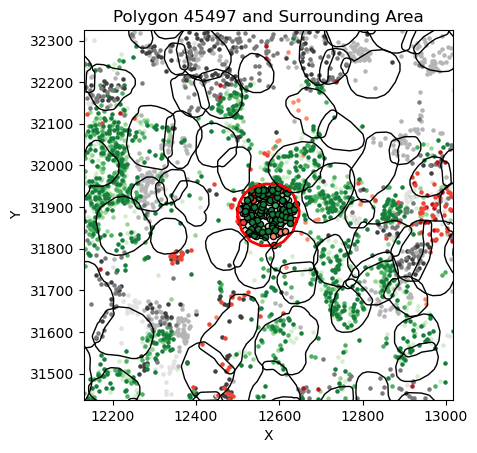

33392 bc_001-bc_024-bc_029-bc_031-bc_087 0.27741935483870966


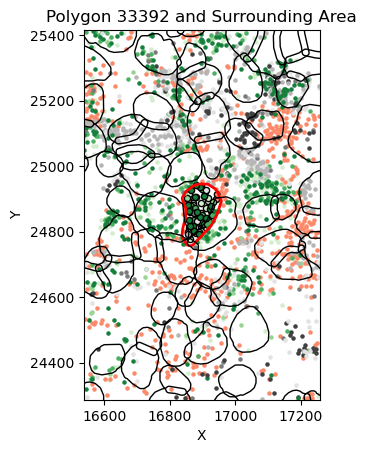

48850 bc_031-bc_068-bc_085-bc_087 0.631578947368421


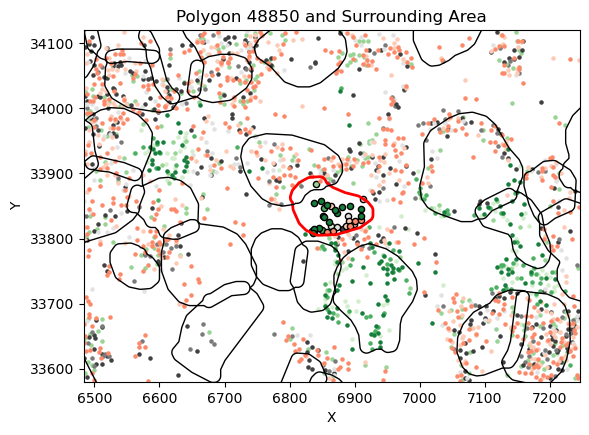

44429 bc_067-bc_087 0.6271186440677966


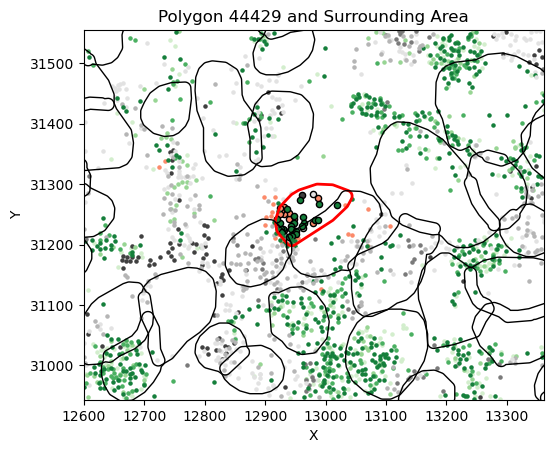

35291 bc_001 0.7319587628865979


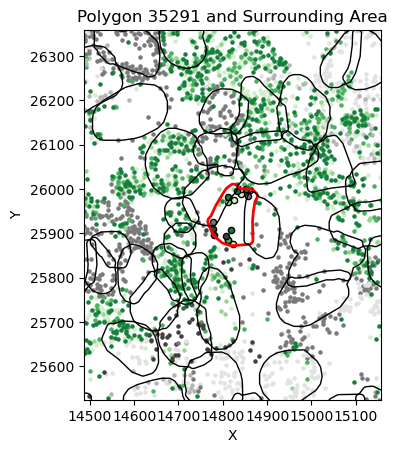

39875 bc_067-bc_077-bc_087 0.5185185185185185


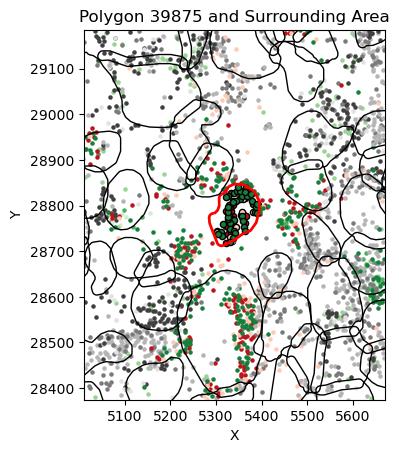

36051 bc_041-bc_067-bc_077-bc_087 0.6119402985074627


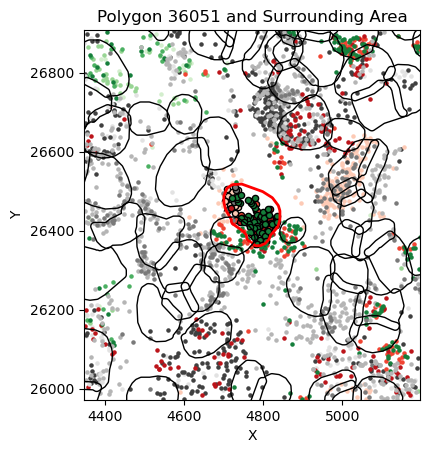

38435 bc_001-bc_024-bc_029-bc_031-bc_048-bc_081-bc_087 0.291866028708134


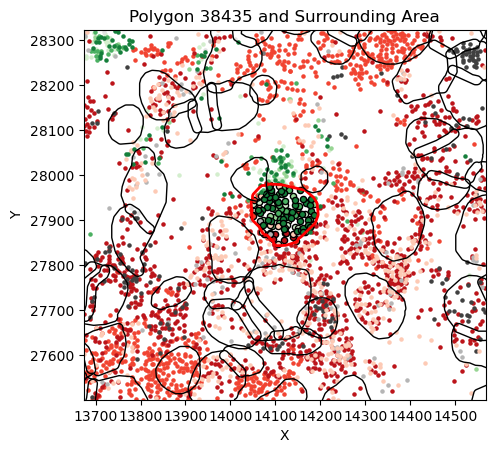

40116 bc_001-bc_024-bc_029-bc_031-bc_087 0.4520547945205479


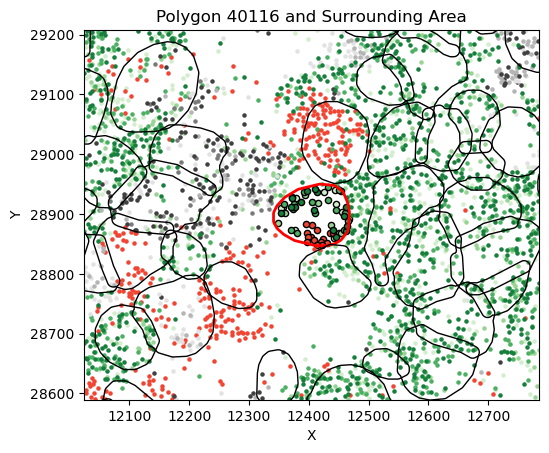

38120 bc_001-bc_029-bc_031-bc_087-bc_092 0.5757575757575758


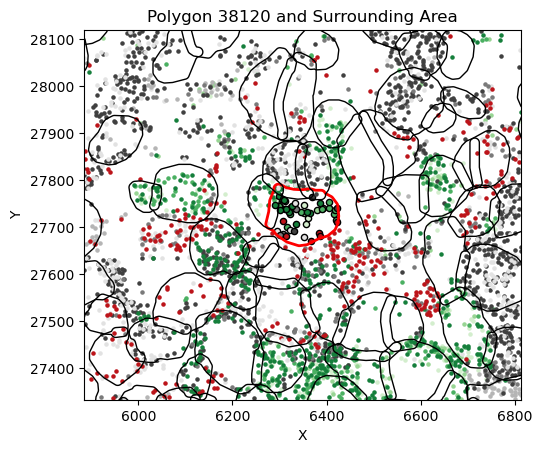

34728 bc_031-bc_087 0.6724137931034483


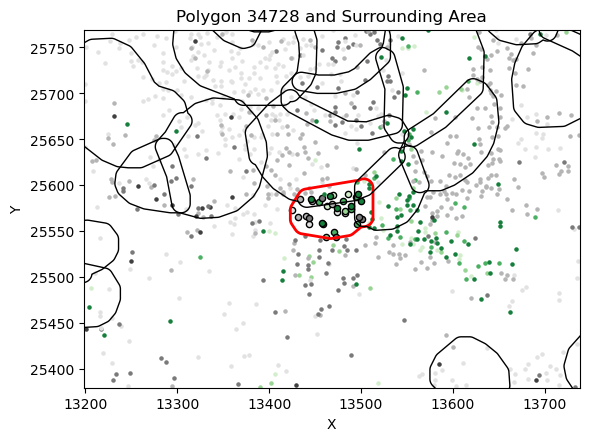

53225 bc_001-bc_019 0.7115384615384616


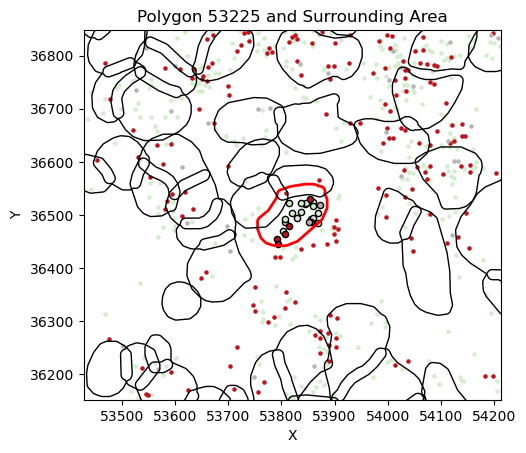

36238 bc_001-bc_029-bc_031-bc_048-bc_060-bc_087 0.6319018404907976


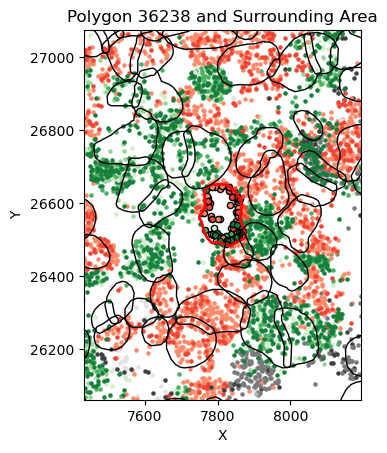

41765 bc_001-bc_029-bc_031-bc_087 0.4108527131782946


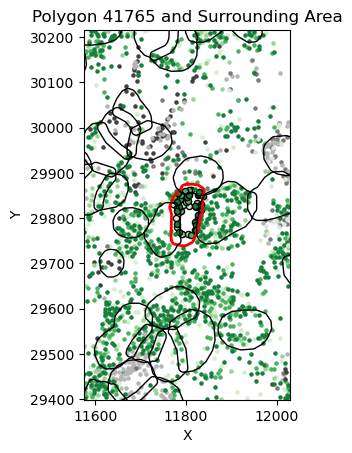

2130 bc_001-bc_005-bc_025-bc_030 0.7333333333333333


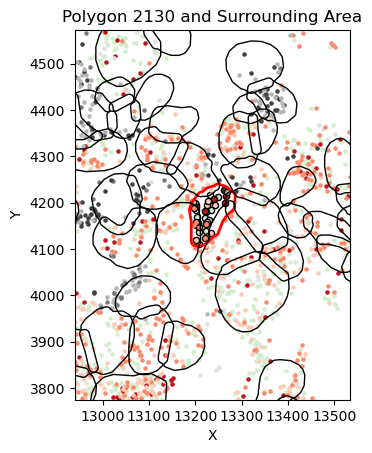

54855 bc_001-bc_019-bc_064 0.6296296296296297


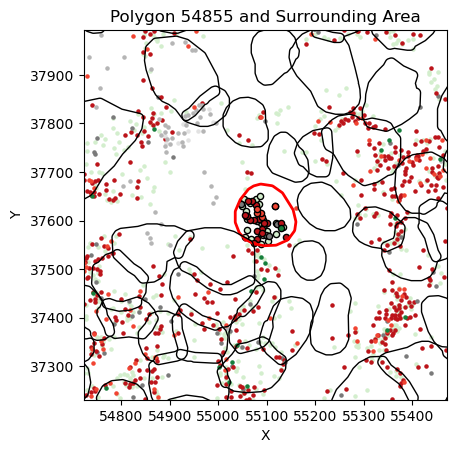

46088 bc_001-bc_029-bc_031-bc_087 0.3700787401574803


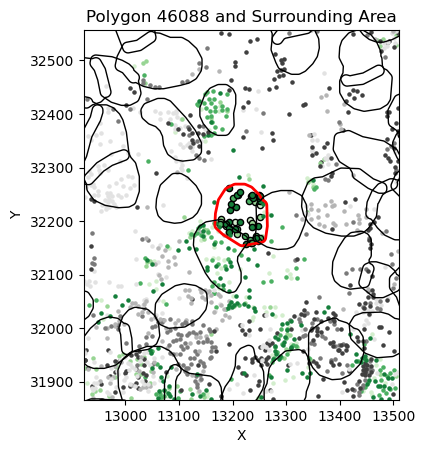

36911 bc_001-bc_029-bc_031-bc_087 0.25146198830409355


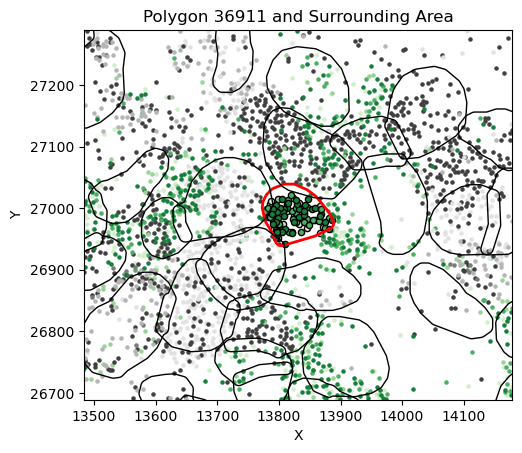

40521 bc_001-bc_031-bc_087 0.3509933774834437


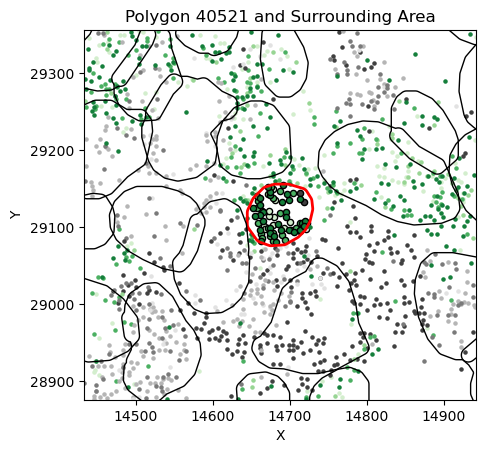

56170 bc_001 0.7227722772277227


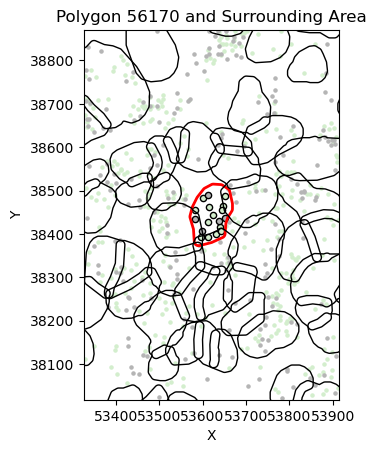

38403 bc_001-bc_031-bc_048-bc_081-bc_087 0.5572519083969466


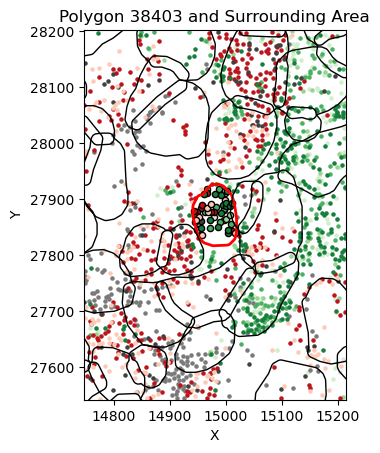

35608 bc_001-bc_029-bc_031-bc_087 0.3543307086614173


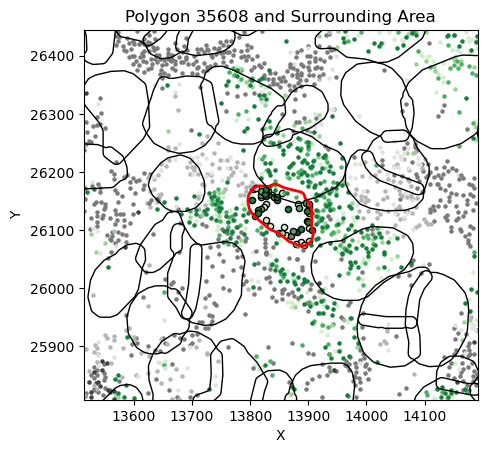

45558 bc_001-bc_029-bc_031-bc_087 0.2909090909090909


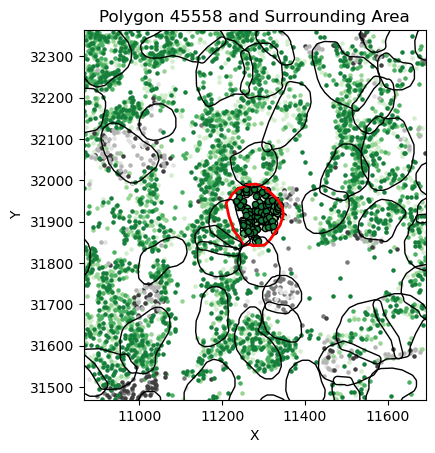

41748 bc_001-bc_002-bc_029-bc_031-bc_059-bc_064-bc_085-bc_087 0.5614973262032086


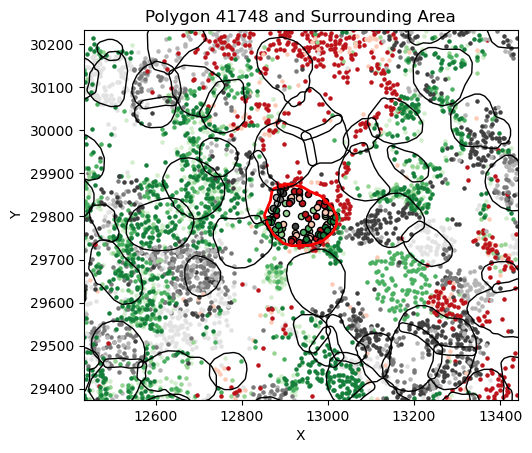

47514 bc_031-bc_087 0.5959595959595959


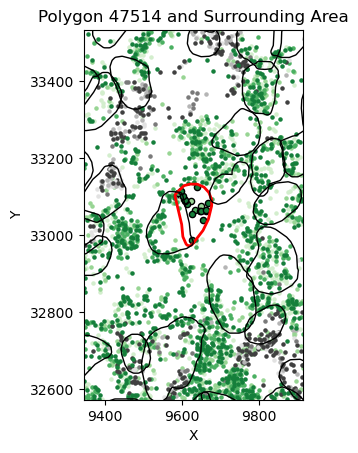

35475 bc_004-bc_041-bc_067-bc_077-bc_087 0.7218543046357616


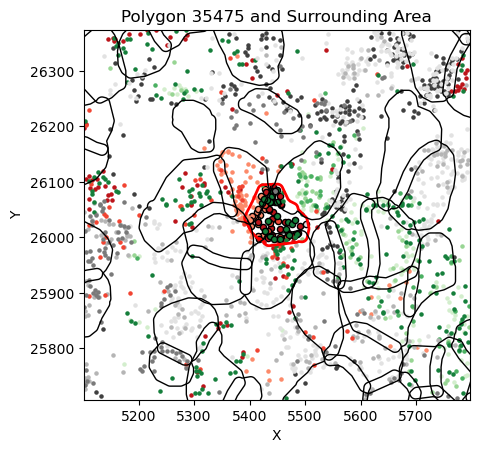

46140 bc_001-bc_029-bc_031-bc_087 0.3333333333333333


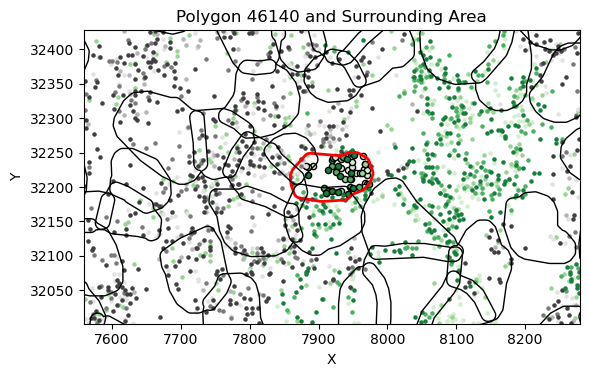

42644 bc_001-bc_029-bc_031-bc_087 0.47540983606557374


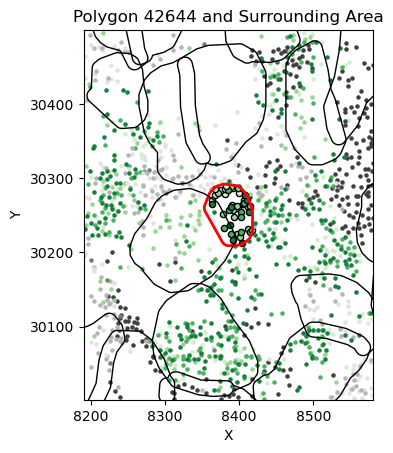

33300 bc_001-bc_031-bc_087 0.35766423357664234


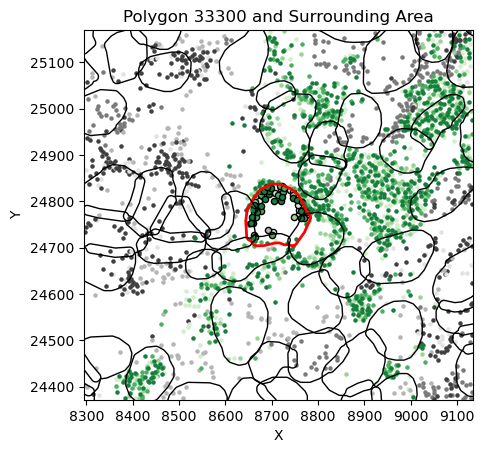

29622 bc_031-bc_066-bc_087 0.6869565217391305


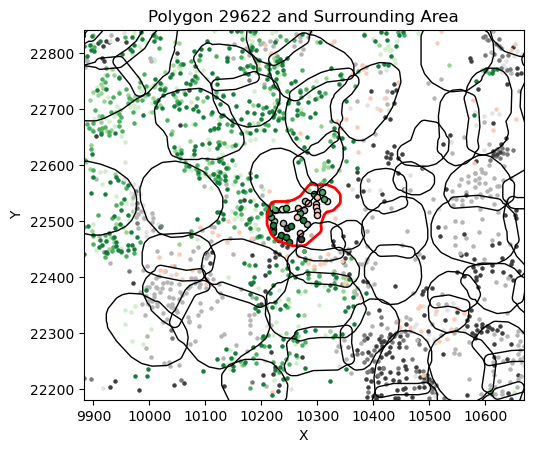

41028 bc_001-bc_029-bc_031-bc_087 0.3463414634146341


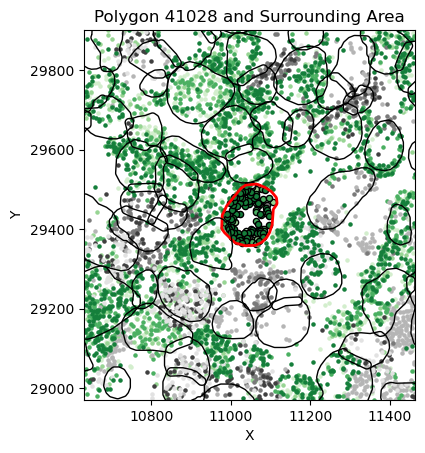

42187 bc_001-bc_024-bc_031-bc_087 0.4666666666666667


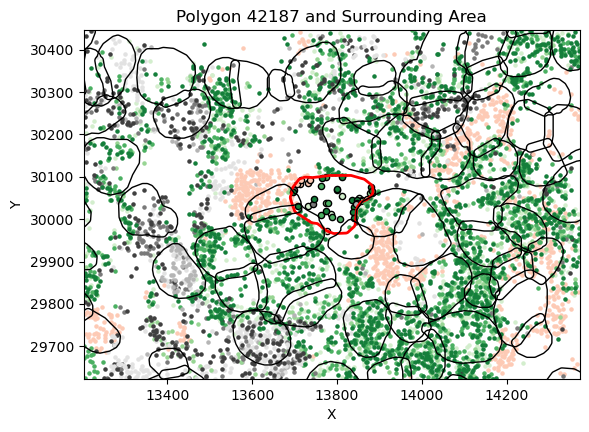

43482 bc_001 0.6494845360824743


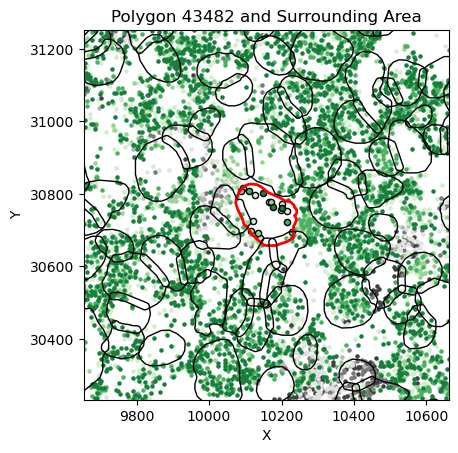

52505 bc_001-bc_019 0.6814159292035398


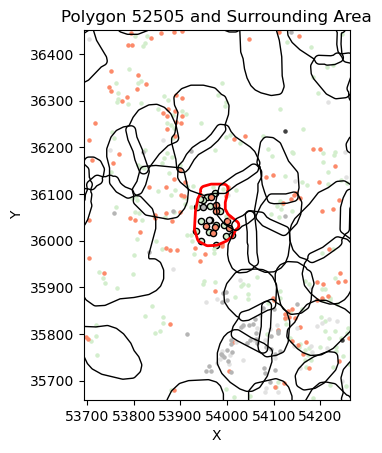

38684 bc_001-bc_029-bc_031-bc_087-bc_092 0.27607361963190186


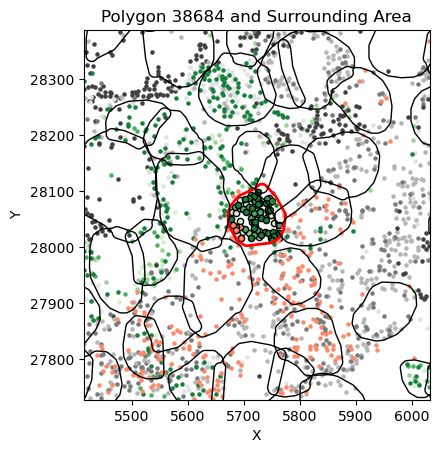

44105 bc_001-bc_085 0.5929203539823009


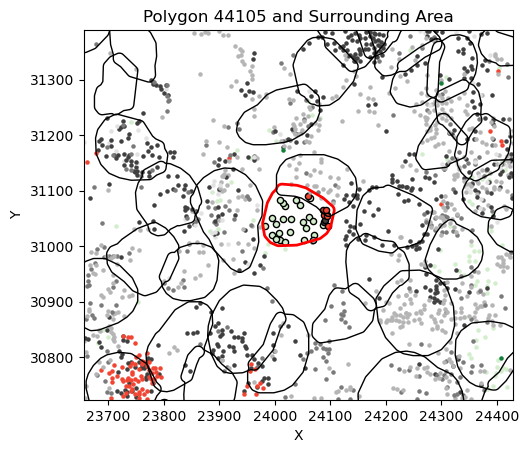

31845 bc_001-bc_009-bc_024-bc_031-bc_048-bc_087 0.6834532374100719


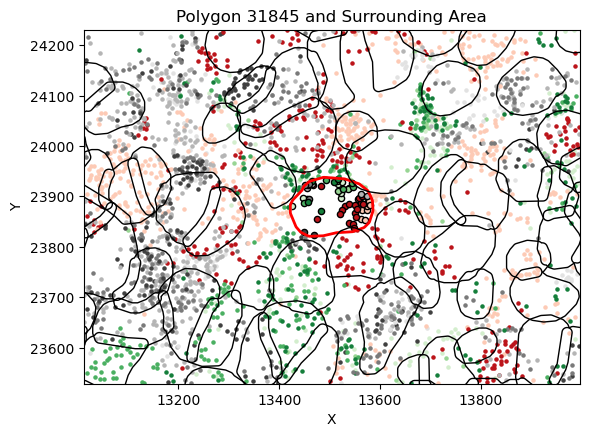

37272 bc_001-bc_048-bc_081-bc_087 0.6949152542372882


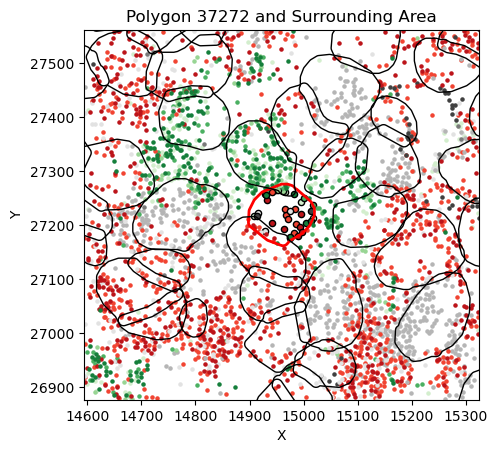

42996 bc_087 0.6666666666666666


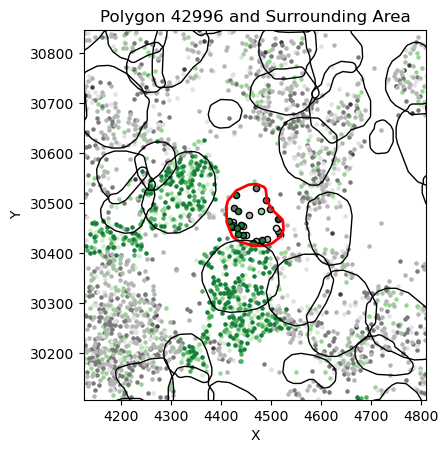

46399 bc_087 0.7391304347826086


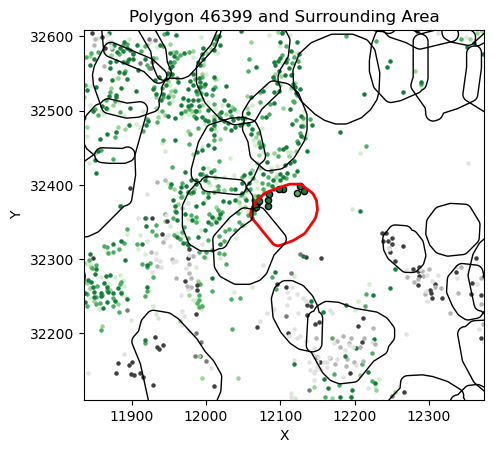

45682 bc_001-bc_029-bc_031-bc_087 0.21428571428571427


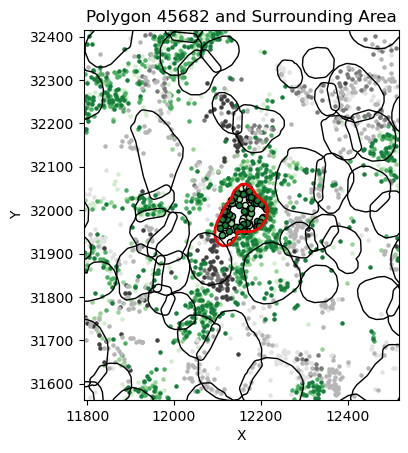

46484 bc_001-bc_024-bc_029-bc_031-bc_087 0.40823970037453183


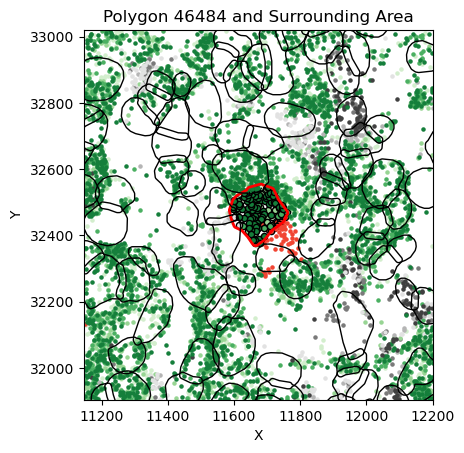

In [156]:
for c,cell_id in enumerate(cell_ids_to_check):
    # print(cell_id,mapping_dict[cell_id],df[df['cell_id']==cell_id]['called_barcodes'].values[0])

    # print(df[df['cell_id']==cell_id]['area'].values[0])
    # print(adata_genes.obs.loc[cell_id]['total_counts']) 

    print(cell_id,names_here[ix][c],braycurtis_dist_square[83,ix][0][c])

    region = get_polygons_around_polygon(sg_obj,cell_id,image_scale=10)

    # gene_names = [    'bc_001','bc_029','bc_031','bc_087']

    # gene_names = ['bc_029']
    # gene_names = ['bc_001','bc_024','bc_029','bc_031','bc_087']


    # gene_names = ['bc_024']
        # 'bc_001','bc_029','bc_031','bc_087'



    gene_names = get_all_barcodes_in_region(df,region['object_id'].values)

    true_genes = ['bc_001','bc_029','bc_031','bc_087']

    c_map = {gene:sns.color_palette('Greens',4)[i] for i,gene in enumerate(true_genes)}
    
    g1 = 0
    g2 = 0
    for g,gene in enumerate(gene_names):
        if gene not in true_genes:
            if gene not in names_here[ix][c]:
                c_map[gene] = sns.color_palette('Greys',4)[g1%4]
                g1 += 1
            else:
                c_map[gene] = sns.color_palette('Reds',4)[g2%4]
                g2 += 1

    # c_map ] 
    # gene_names.append('SOX10')

    # print(gene_names)

    # gene_names = df[df['cell_id']==cell_id]['called_barcodes'].values[0] + df[df['cell_id']=='60']['called_barcodes'].values[0]

    tools.plot_polygon_and_points(sg_obj,cell_id,gene_names=gene_names,annotate=False,image_scale=5,
                                  interior_marker='o',exterior_marker='.',marker_size=20,color_map=c_map,
                                  )
    # sg_obj_only_bcs.plot_polygon_and_points(mapping_dict[cell_id],gene_names=gene_names,annotate=False)

In [173]:
# normalizing by the total number of barcodes

random_matrix = has_bcs[barcode_cols].iloc[random_indices]
random_matrix_norm = random_matrix.div(random_matrix.sum(axis=1), axis=0)

braycurtis_dist_norm = scipy.spatial.distance.pdist(random_matrix_norm,metric='braycurtis')

In [174]:
braycurtis_dist_norm_square = scipy.spatial.distance.squareform(braycurtis_dist_norm)

In [251]:

cluster = AggCluster(distance_threshold=0.5,n_clusters=None,linkage='average',affinity='precomputed').fit(braycurtis_dist_norm_square)

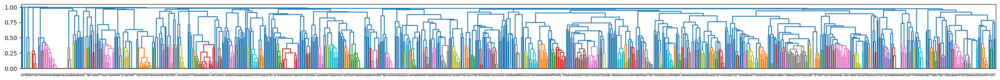

In [252]:
plt.figure(figsize=(30,2))

labels_here = [l if l.count('_') > 2 else '' for l in has_bcs['barcode_names'].values[random_indices]]
# plot_dendrogram(cluster,labels=has_bcs['barcode_names'].values[random_indices],leaf_rotation=90,leaf_font_size=6,color_threshold=0.5, truncate_mode="level",)
plot_dendrogram(cluster,leaf_rotation=90,leaf_font_size=3,color_threshold=0.4, truncate_mode="level",)

# plot_dendrogram(cluster,labels=labels_here,leaf_rotation=90,leaf_font_size=2)

In [268]:
focal_combo = np.where(np.isin(names_here,['bc_001-bc_029-bc_031-bc_087','bc_001-bc_024-bc_029-bc_031-bc_087','bc_001-bc_031-bc_087','bc_001-bc_029-bc_087']))
cluster.labels_[focal_combo]
# np.where(names_here=='bc_001-bc_029-bc_031-bc_087')

array([46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46,
       46])

Text(0.5, 0, 'Bray-Curtis Dissimiliarity')

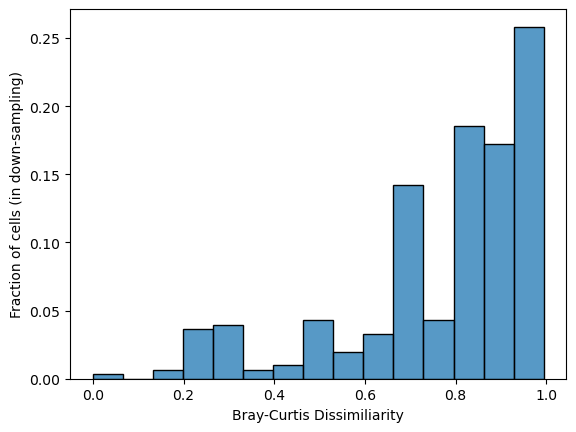

In [255]:
ix = np.where(braycurtis_dist_norm_square[83,:] < 1)
sns.histplot(braycurtis_dist_norm_square[83,:][ix],stat='probability')

plt.ylabel('Fraction of cells (in down-sampling)')
plt.xlabel('Bray-Curtis Dissimiliarity')

In [256]:
# ix = np.where(braycurtis_dist_norm_square[83,:] < 0.75)

# [(z,x,y) for z,x,y in zip(cells_here[ix],names_here[ix ],braycurtis_dist_square[83,ix][0])]

# cell_ids_to_check = cells_here[ix]

ix = np.where(cluster.labels_ == cluster.labels_[83])

# ix = (np.array([14,620]),)

[(z,x,y) for z,x,y in zip(cells_here[ix],names_here[ix ],braycurtis_dist_square[83,ix][0])]

cell_ids_to_check = list(cells_here[ix])
# cell_ids_to_check.append(cells_here[620])

In [258]:
cluster.labels_[83]

46

In [259]:
ix

(array([ 14,  69,  83,  96, 105, 175, 215, 222, 227, 228, 245, 280, 294,
        312, 317, 354, 391, 418, 447, 486, 560, 574, 582, 585, 610, 620,
        634, 650, 666, 669, 751, 812, 958, 968, 988, 990]),)

In [260]:
cell_ids_to_check

['43332',
 '47023',
 '36042',
 '44900',
 '42702',
 '33106',
 '46265',
 '45497',
 '33392',
 '48850',
 '35291',
 '38435',
 '40116',
 '38120',
 '34728',
 '41765',
 '46088',
 '36911',
 '40521',
 '34640',
 '35608',
 '45558',
 '41748',
 '47514',
 '46140',
 '42644',
 '33300',
 '41028',
 '42187',
 '43482',
 '51908',
 '38684',
 '42996',
 '46399',
 '45682',
 '46484']

43332 bc_029-bc_087 0.4648101342264327 46


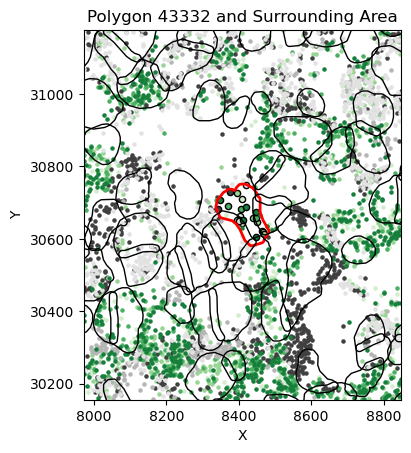

47023 bc_001-bc_031-bc_087 0.19677790447370816 46


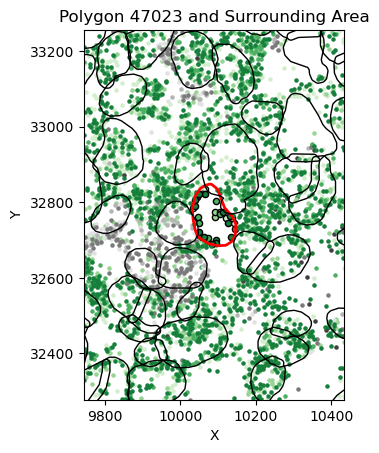

36042 bc_001-bc_029-bc_031-bc_087 0.0 46


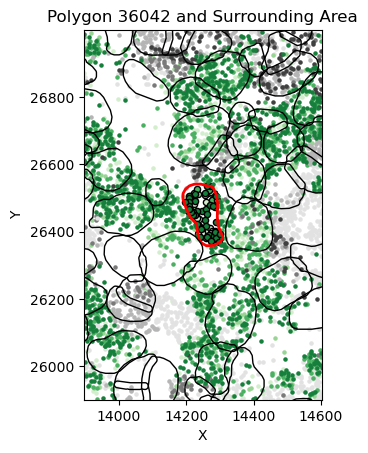

44900 bc_087 0.23091675061643227 46


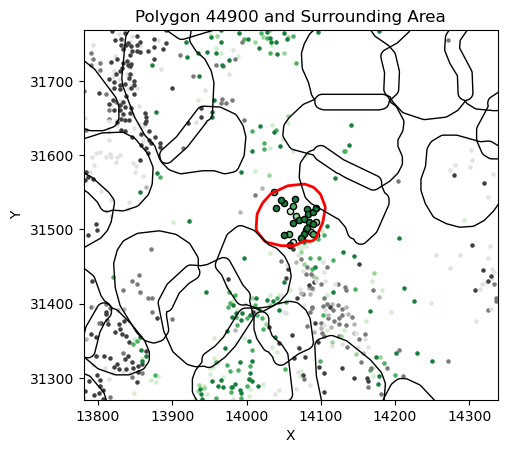

42702 bc_001-bc_029-bc_031-bc_087 0.22117377761644227 46


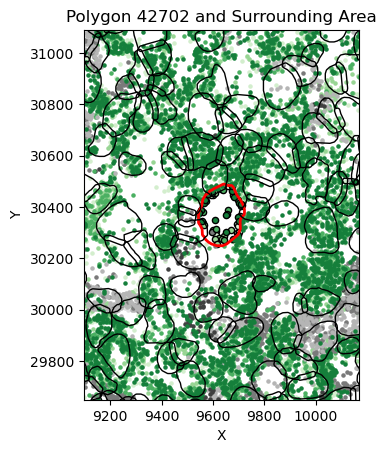

33106 bc_087 0.21226874447882013 46


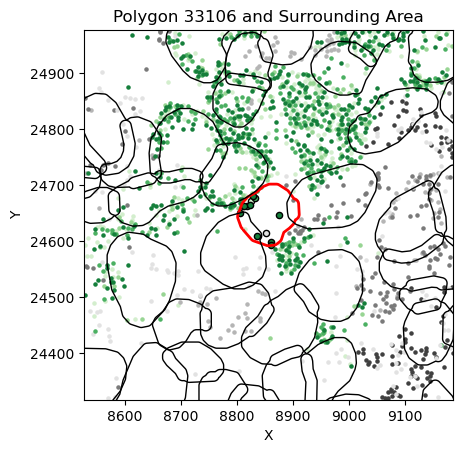

46265 bc_001-bc_029-bc_031-bc_087 0.20976492744377018 46


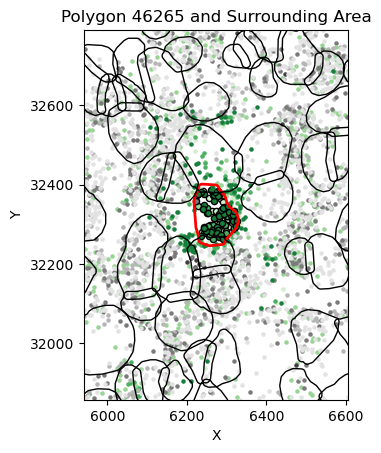

45497 bc_001-bc_002-bc_029-bc_031-bc_068-bc_085-bc_087 0.3229868179042639 46


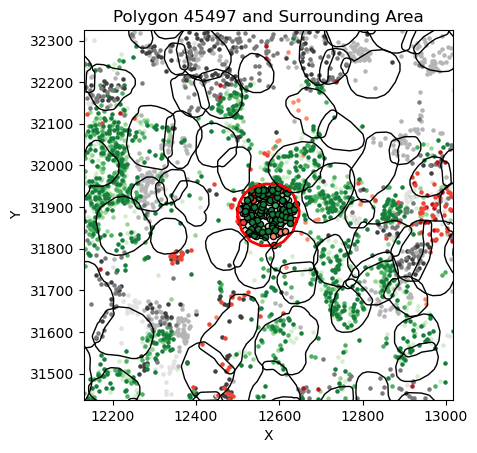

33392 bc_001-bc_024-bc_029-bc_031-bc_087 0.27165224301393925 46


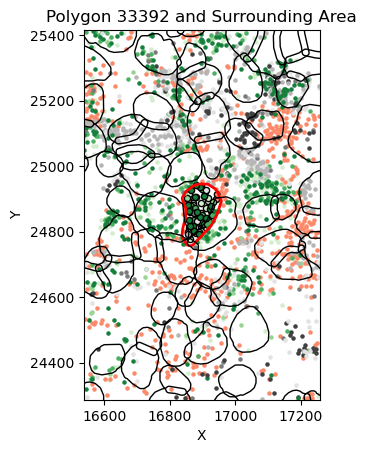

48850 bc_031-bc_068-bc_085-bc_087 0.46690778334475164 46


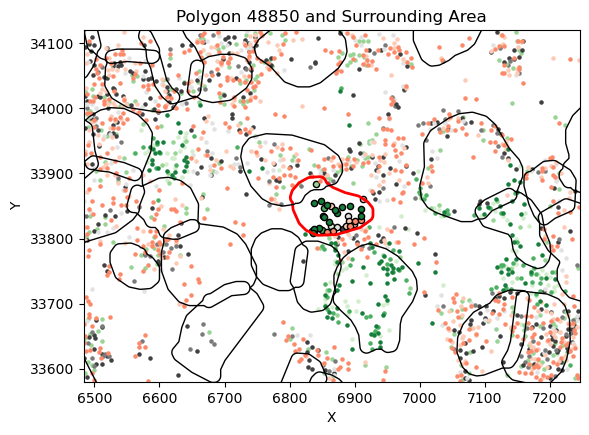

35291 bc_001 0.31997187363027046 46


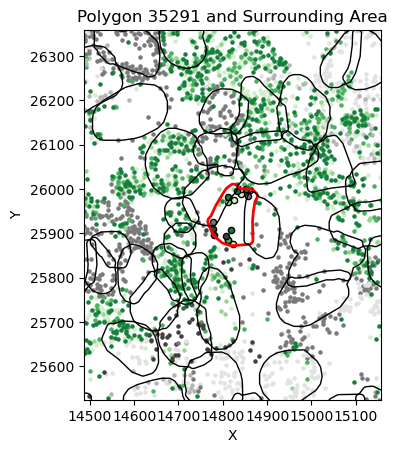

38435 bc_001-bc_024-bc_029-bc_031-bc_048-bc_081-bc_087 0.3394352483540454 46


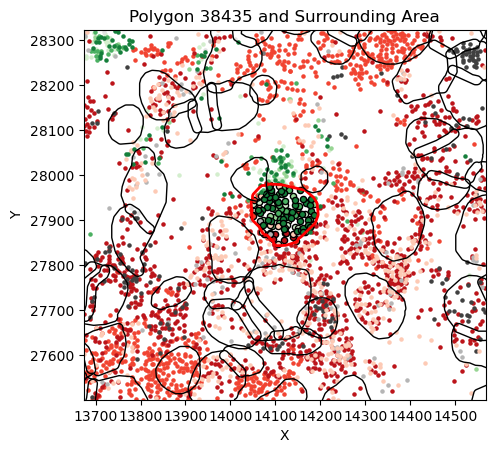

40116 bc_001-bc_024-bc_029-bc_031-bc_087 0.4165879616831619 46


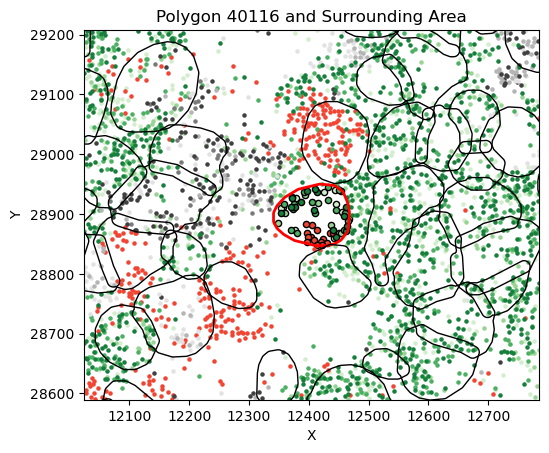

38120 bc_001-bc_029-bc_031-bc_087-bc_092 0.5089562974126391 46


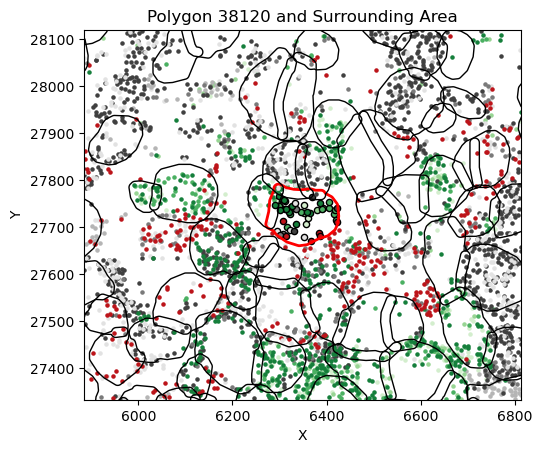

34728 bc_031-bc_087 0.5870680820859275 46


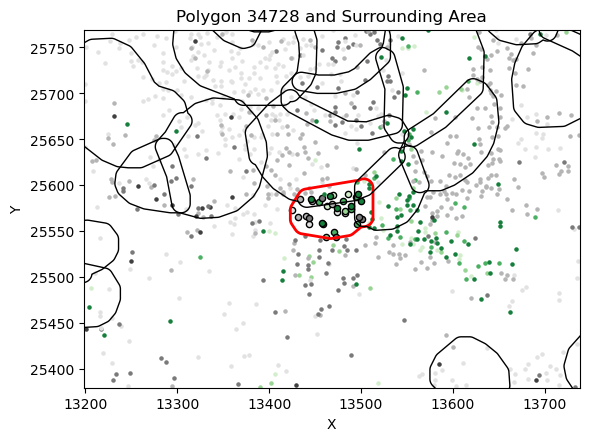

41765 bc_001-bc_029-bc_031-bc_087 0.28405064244389155 46


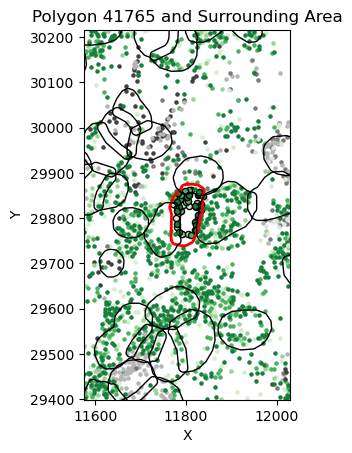

46088 bc_001-bc_029-bc_031-bc_087 0.22389241862604461 46


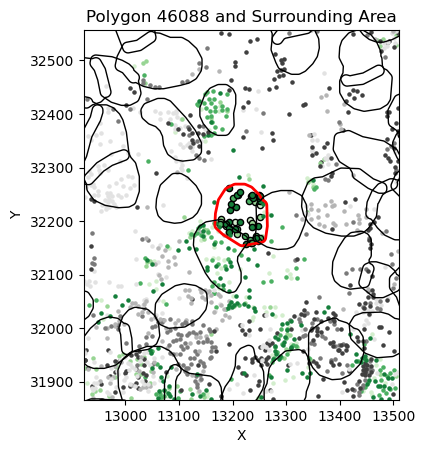

36911 bc_001-bc_029-bc_031-bc_087 0.2936158537983599 46


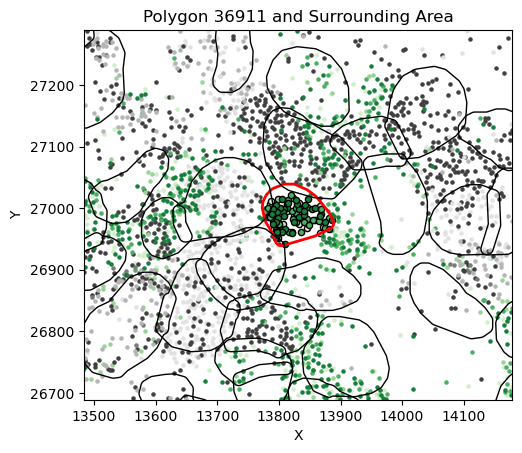

40521 bc_001-bc_031-bc_087 0.3280590738652211 46


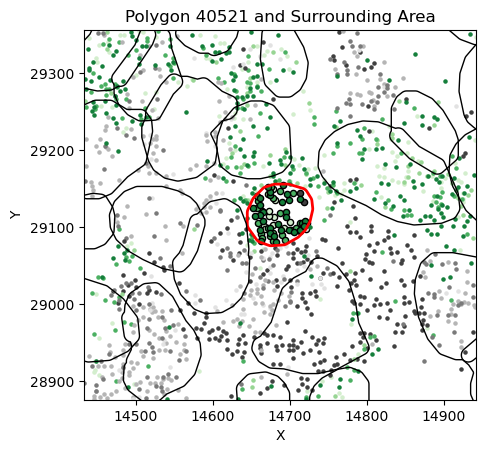

34640  0.3240506367769705 46


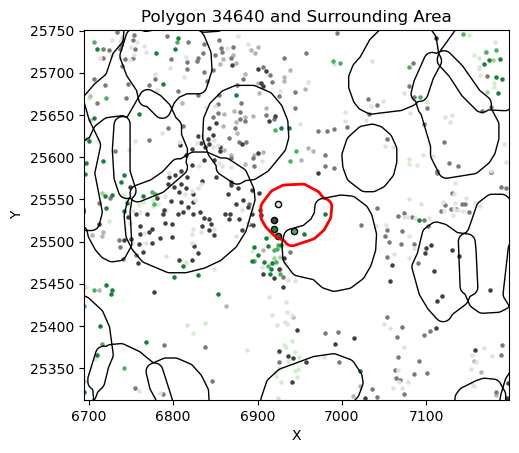

35608 bc_001-bc_029-bc_031-bc_087 0.24525316964607982 46


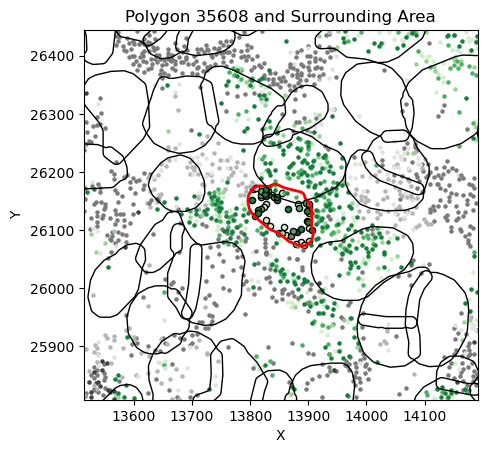

45558 bc_001-bc_029-bc_031-bc_087 0.15100100247235548 46


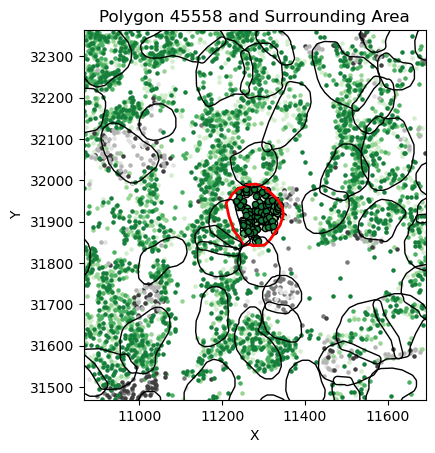

41748 bc_001-bc_002-bc_029-bc_031-bc_059-bc_064-bc_085-bc_087 0.5629395218810025 46


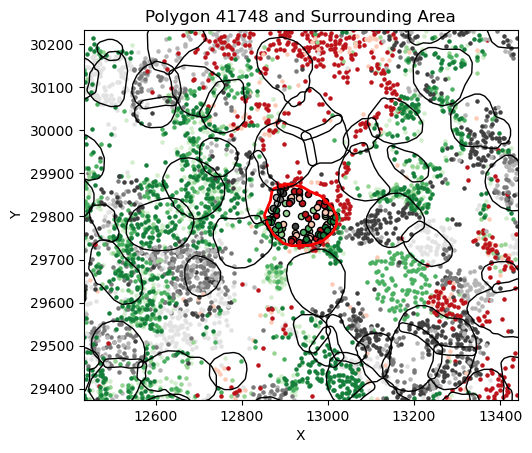

47514 bc_031-bc_087 0.2930379756658538 46


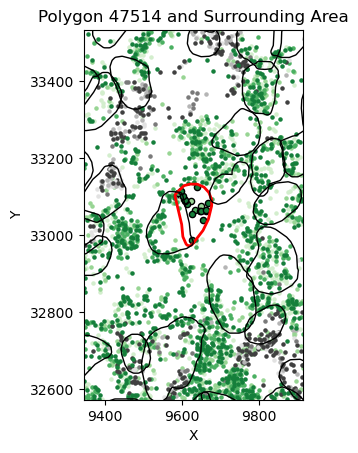

46140 bc_001-bc_029-bc_031-bc_087 0.25291140968934916 46


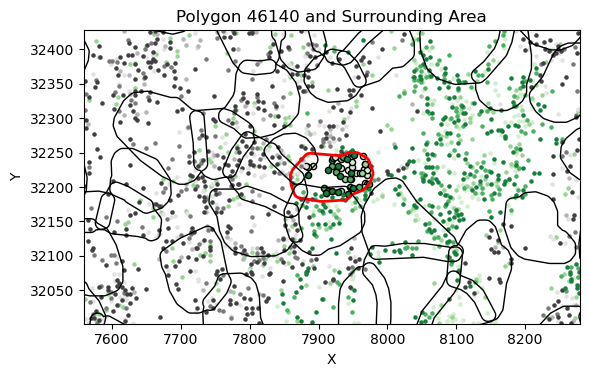

42644 bc_001-bc_029-bc_031-bc_087 0.4359729260152486 46


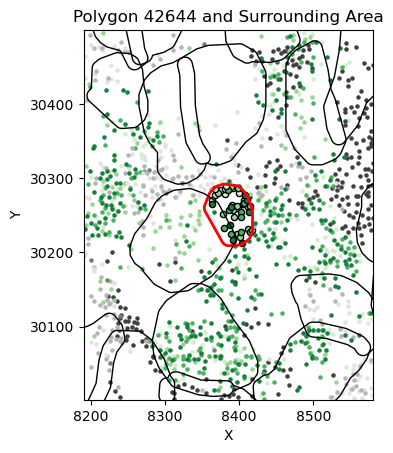

33300 bc_001-bc_031-bc_087 0.27346138630295264 46


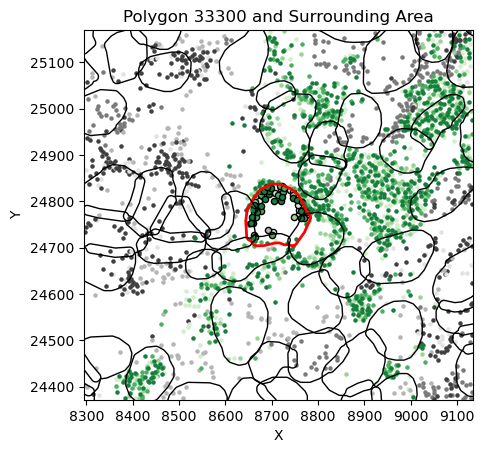

41028 bc_001-bc_029-bc_031-bc_087 0.2525617926549377 46


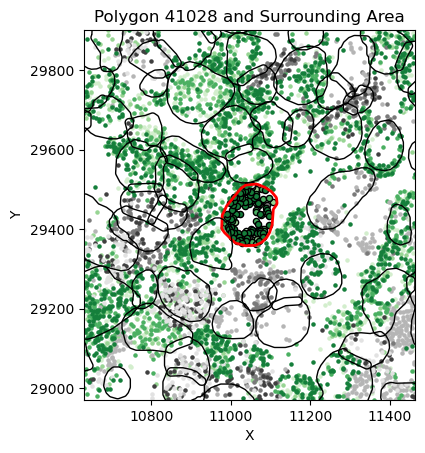

42187 bc_001-bc_024-bc_031-bc_087 0.2899043050167066 46


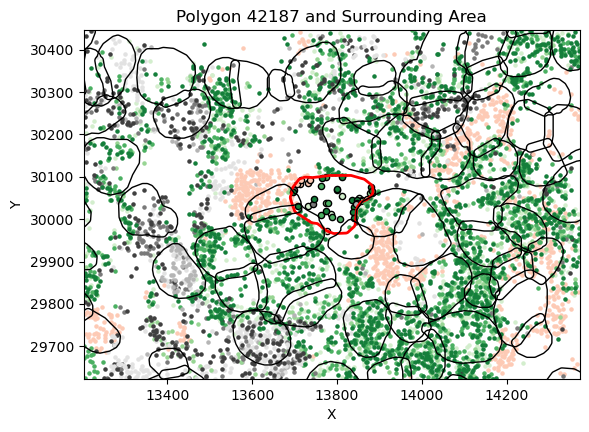

43482 bc_001 0.32700422444608734 46


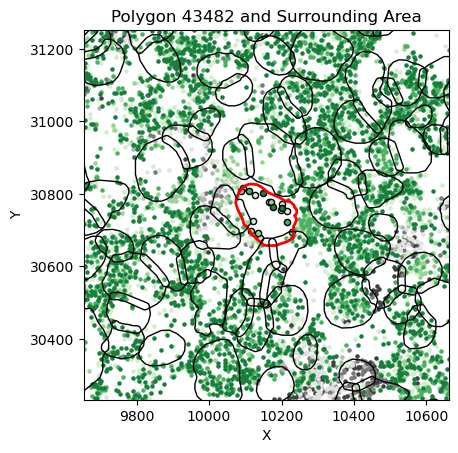

51908  0.2278480874551343 46


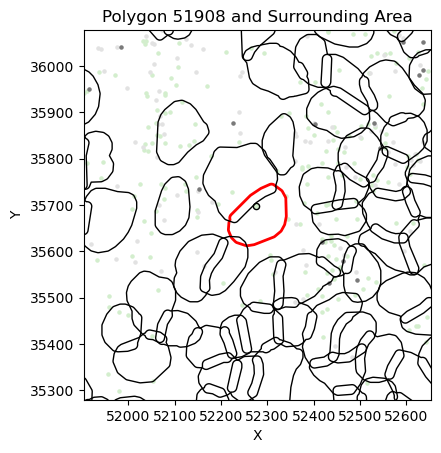

38684 bc_001-bc_029-bc_031-bc_087-bc_092 0.29309825228278497 46


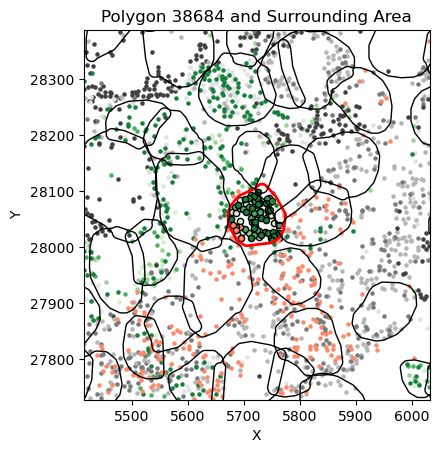

42996 bc_087 0.3793103394644528 46


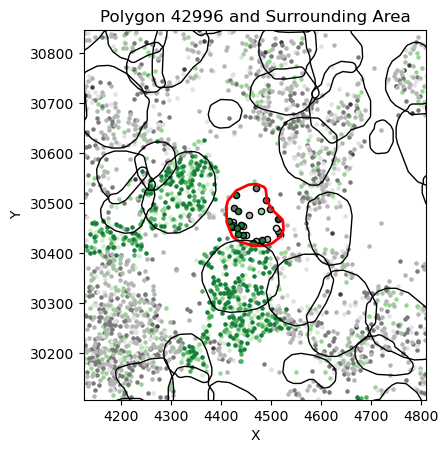

46399 bc_087 0.4430379739997885 46


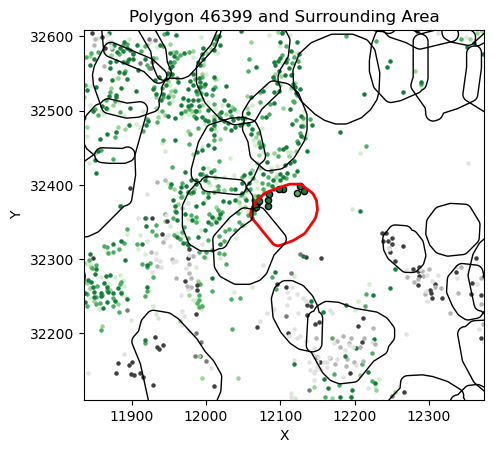

45682 bc_001-bc_029-bc_031-bc_087 0.23424833666034117 46


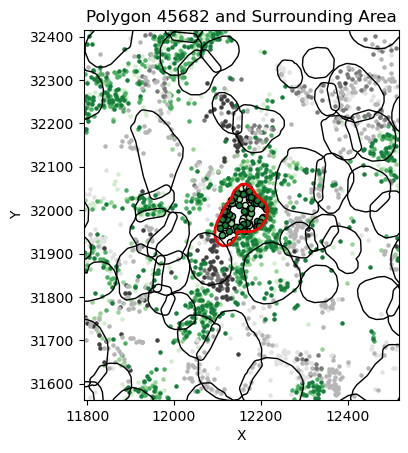

46484 bc_001-bc_024-bc_029-bc_031-bc_087 0.22629949001136926 46


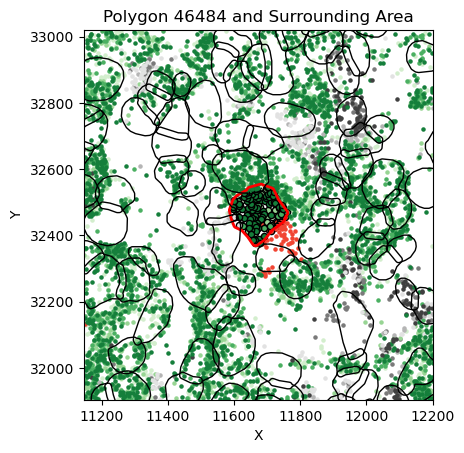

In [262]:
for c,cell_id in enumerate(cell_ids_to_check):
# for c,cell_id in enumerate(['43332','42644']):
    # print(cell_id,mapping_dict[cell_id],df[df['cell_id']==cell_id]['called_barcodes'].values[0])

    # print(df[df['cell_id']==cell_id]['area'].values[0])
    # print(adata_genes.obs.loc[cell_id]['total_counts']) 

    print(cell_id,names_here[ix][c],braycurtis_dist_norm_square[83,ix][0][c],cluster.labels_[ix][c])

    region = get_polygons_around_polygon(sg_obj,cell_id,image_scale=10)

    # gene_names = [    'bc_001','bc_029','bc_031','bc_087']

    # gene_names = ['bc_029']
    # gene_names = ['bc_001','bc_024','bc_029','bc_031','bc_087']


    # gene_names = ['bc_024']
        # 'bc_001','bc_029','bc_031','bc_087'



    gene_names = get_all_barcodes_in_region(df,region['object_id'].values)

    true_genes = ['bc_001','bc_029','bc_031','bc_087']

    c_map = {gene:sns.color_palette('Greens',4)[i] for i,gene in enumerate(true_genes)}
    
    g1 = 0
    g2 = 0
    for g,gene in enumerate(gene_names):
        if gene not in true_genes:
            if gene not in names_here[ix][c]:
                c_map[gene] = sns.color_palette('Greys',4)[g1%4]
                g1 += 1
            else:
                c_map[gene] = sns.color_palette('Reds',4)[g2%4]
                g2 += 1

    # c_map ] 
    # gene_names.append('SOX10')

    # print(gene_names)

    # gene_names = df[df['cell_id']==cell_id]['called_barcodes'].values[0] + df[df['cell_id']=='60']['called_barcodes'].values[0]

    tools.plot_polygon_and_points(sg_obj,cell_id,gene_names=gene_names,annotate=False,image_scale=5,
                                  interior_marker='o',exterior_marker='.',marker_size=20,color_map=c_map,
                                  )
    # sg_obj_only_bcs.plot_polygon_and_points(mapping_dict[cell_id],gene_names=gene_names,annotate=False)

Ok so from all the analysis above, it seems like we should be able to cluster based on these normalized bray-curtis dissimilarities. Let's also pick a minimum number of spots detected to be included in the analysis at all.

In [16]:
total_bc_threshold = 10

# include cells with at least 10 barcode spots
has_bcs = df[df[barcode_cols].sum(axis=1) >= 10]
matrix = has_bcs[barcode_cols]

matrix_norm = matrix.div(matrix.sum(axis=1), axis=0)
braycurtis_dist = scipy.spatial.distance.pdist(matrix_norm,metric='braycurtis')

braycurtis_dist_square = scipy.spatial.distance.squareform(braycurtis_dist)

In [109]:
threshold = 0.4
cluster = AggCluster(distance_threshold=threshold,n_clusters=None,linkage='average',affinity='precomputed').fit(braycurtis_dist_square)

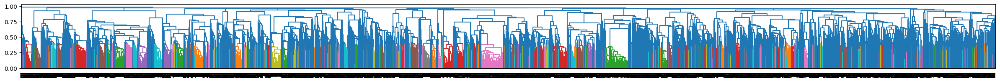

In [110]:
plt.figure(figsize=(30,2))

# labels_here = [l if l.count('_') > 2 else '' for l in has_bcs['barcode_names'].values[random_indices]]
# plot_dendrogram(cluster,labels=has_bcs['barcode_names'].values[random_indices],leaf_rotation=90,leaf_font_size=6,color_threshold=0.5, truncate_mode="level",)
tools.plot_dendrogram(cluster,leaf_rotation=90,leaf_font_size=3,color_threshold=threshold, truncate_mode="level",)

# plot_dendrogram(cluster,labels=labels_here,leaf_rotation=90,leaf_font_size=2)

In [111]:
cluster_name_cutoff = 3


obj_clusters = {obj_id:clus for obj_id,clus in zip(matrix.index,cluster.labels_)}

cluster_objects = {}
cluster_barcode_names = {}
cluster_found_barcodes = {}
cluster_n_found_barcodes = {}

for clu in np.unique(cluster.labels_):
    cluster_objects[clu] = matrix.index[cluster.labels_ == clu]

    avg_bc_counts = np.mean(matrix[cluster.labels_ == clu],axis=0)
    # print(avg_bc_counts)
    # break

    found_bcs = []

    for bc in barcode_cols:
        if avg_bc_counts[bc] > cutoff:
            found_bcs.append(bc)

    print(clu,found_bcs)

    cluster_found_barcodes[clu] = found_bcs
    cluster_n_found_barcodes[clu] = len(found_bcs)

    cluster_barcode_names[clu] = '-'.join(sorted(found_bcs))

0 ['bc_091']
1 []
2 ['bc_063', 'bc_066']
3 ['bc_094']
4 []
5 ['bc_003', 'bc_009']
6 ['bc_094']
7 ['bc_001', 'bc_031', 'bc_033', 'bc_087']
8 ['bc_007', 'bc_013', 'bc_054', 'bc_060']
9 ['bc_006', 'bc_018', 'bc_043']
10 ['bc_021', 'bc_049', 'bc_079']
11 ['bc_019', 'bc_025', 'bc_074', 'bc_092']
12 ['bc_074', 'bc_083']
13 ['bc_008', 'bc_040']
14 []
15 ['bc_001', 'bc_024', 'bc_029', 'bc_031', 'bc_066', 'bc_087', 'bc_091']
16 ['bc_040', 'bc_052', 'bc_092', 'bc_093']
17 ['bc_030', 'bc_060']
18 ['bc_060']
19 ['bc_022', 'bc_087']
20 ['bc_026', 'bc_041']
21 ['bc_021', 'bc_028', 'bc_060', 'bc_067', 'bc_074']
22 ['bc_003', 'bc_009', 'bc_066', 'bc_087']
23 ['bc_085']
24 ['bc_024', 'bc_025', 'bc_041']
25 ['bc_031', 'bc_047', 'bc_093']
26 ['bc_008', 'bc_035', 'bc_059', 'bc_063', 'bc_074', 'bc_081']
27 ['bc_066', 'bc_091']
28 ['bc_008', 'bc_041', 'bc_096']
29 ['bc_016']
30 ['bc_002', 'bc_060']
31 ['bc_025', 'bc_079', 'bc_083']
32 ['bc_028', 'bc_092']
33 ['bc_048']
34 ['bc_060']
35 ['bc_049', 'bc_079']


In [112]:
adata_genes.obs['bc_cluster'] = [obj_clusters[obj_id] if obj_id in obj_clusters else np.nan for obj_id in adata_genes.obs.index]
adata_genes.obs['bc_cluster_n_bcs'] = [cluster_n_found_barcodes[obj_clusters[obj_id]] if obj_id in obj_clusters else np.nan for obj_id in adata_genes.obs.index]
adata_genes.obs['bc_cluster_found_bcs'] = [cluster_found_barcodes[obj_clusters[obj_id]] if obj_id in obj_clusters else np.nan for obj_id in adata_genes.obs.index]
adata_genes.obs['bc_cluster_bc_names'] = [cluster_barcode_names[obj_clusters[obj_id]] if obj_id in obj_clusters else np.nan for obj_id in adata_genes.obs.index]

In [123]:


triple_bc_clusters = adata_genes.obs[adata_genes.obs['bc_cluster_n_bcs'] >= 3]    

cs,counts = np.unique([int(x) for x in triple_bc_clusters['bc_cluster'].values],return_counts=True)

cs[np.argsort(counts)[::-1]]

array([ 311,  372,   91, 1214,   39, 1096,  512,  238, 1114,  644,   31,
        277, 1101,  256,  332,    8,  258,   71,   72,   78,   42,  161,
         92, 1394,   26,  100,  208,  448,  157,  412,  109,   97,  910,
        746,  617, 1020,  538,   55,  965,   28,  564,  176,  756,  195,
         16, 1534,  186,  753,  927,  356,   10, 3176,   49,  481,  155,
        846, 1510,  511,  431,  228,  250,   57, 1408,  396, 1080,  894,
       1254,  651,  684, 1590,  175, 1383,  335,  632, 1315,  863,  539,
        381,  622,   22,  204,  213,  338,  321, 1511, 1522,  344, 1190,
        196,  279,  331,   93,  527,  318,  339,  329,  325,  599,  247,
        300,  255, 1677,  888,  411,  795,  293,  652, 1692, 1442,  394,
        748,  818,   47, 1666,  620,  112,  567,   83,   41,  783,  605,
        222,  438,  371,  467,  454, 1401, 1072,  446, 1820,  981,  407,
       1228, 1148, 2616,  360, 1112,  319, 1404,  309,  232,  167,  340,
        525, 1646,  551, 1658,  127,  889, 1561,  8

In [128]:
cluster.

array([696, 696, 696, ...,  67,  67,  67])

In [124]:
for clu,count in zip(cs[np.argsort(counts)[::-1]],counts[np.argsort(counts)[::-1]]):
    if count > 50:
        print(clu,count,cluster_n_found_barcodes[clu],cluster_barcode_names[clu])

311 1388 4 bc_001-bc_029-bc_031-bc_087
372 1150 5 bc_029-bc_059-bc_064-bc_068-bc_085
91 415 3 bc_041-bc_066-bc_093
1214 389 4 bc_025-bc_060-bc_062-bc_066
39 374 5 bc_030-bc_058-bc_059-bc_083-bc_095
1096 368 3 bc_009-bc_014-bc_021
512 366 3 bc_028-bc_038-bc_053
238 342 4 bc_019-bc_040-bc_041-bc_052
1114 332 4 bc_041-bc_045-bc_047-bc_052
644 236 4 bc_006-bc_019-bc_064-bc_094
31 195 3 bc_025-bc_079-bc_083
277 187 6 bc_025-bc_039-bc_047-bc_058-bc_076-bc_079
1101 185 3 bc_050-bc_065-bc_089
256 182 4 bc_004-bc_048-bc_066-bc_083
332 177 3 bc_024-bc_048-bc_060
8 172 4 bc_007-bc_013-bc_054-bc_060
258 163 3 bc_001-bc_025-bc_030
71 162 4 bc_021-bc_028-bc_060-bc_067
72 161 3 bc_067-bc_077-bc_087
78 151 3 bc_017-bc_085-bc_087
42 146 3 bc_004-bc_041-bc_077
161 146 4 bc_013-bc_024-bc_082-bc_091
92 138 3 bc_021-bc_058-bc_070
1394 136 3 bc_008-bc_084-bc_086
26 135 6 bc_008-bc_035-bc_059-bc_063-bc_074-bc_081
100 124 4 bc_001-bc_024-bc_031-bc_087
208 112 7 bc_001-bc_003-bc_014-bc_033-bc_060-bc_076-bc_094

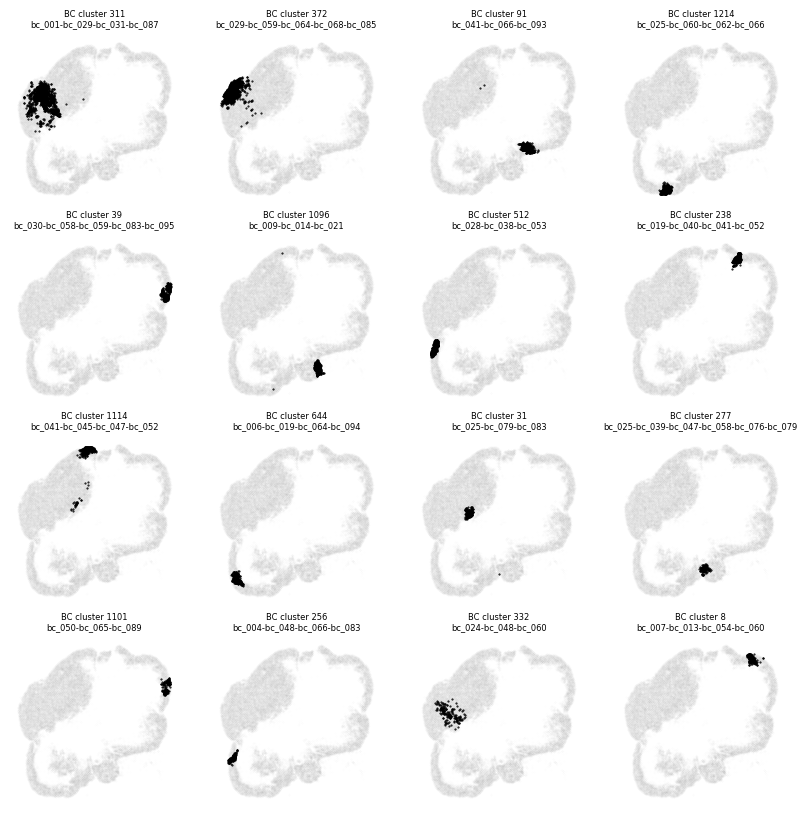

In [134]:
very_common_clusters = cs[np.argsort(counts)[::-1]][:16]
# very_common_clusters = cs[np.argsort(counts)[::-1]][16:32]
# very_common_clusters = cs[np.argsort(counts)[::-1]][32:48]
# very_common_clusters = cs[np.argsort(counts)[::-1]][48:64]
# very_common_clusters = cs[np.argsort(counts)[::-1]][64:80]
# very_common_clusters = cs[np.argsort(counts)[::-1]][80:96]

plt.figure(figsize=(10,10))
for i,clu in enumerate(very_common_clusters):
    
    plt.subplot(4,4,i+1)
    plt.title(f'BC cluster {clu}\n{cluster_barcode_names[clu]}',fontsize=6)

    others = adata_genes[adata_genes.obs['bc_cluster']!=clu]
    plt.scatter(others.obs['center_x'],others.obs['center_y'],marker='o',
            color='gray',alpha=0.01,
            s=0.1)

    this_cluster = adata_genes[adata_genes.obs['bc_cluster']==clu]

    plt.scatter(this_cluster.obs['center_x'],this_cluster.obs['center_y'],marker='o',
            color='k',alpha=1.0,
            s=0.25)
    
    plt.axis('off')
    

In [ ]:
plt.pcolormesh(df[df['cell_id'].isin(cluster)][barcode_cols].values)

In [81]:
adata_genes[adata_genes.obs['bc_cluster']==clu].obs['cell_id'].values

array(['28482'], dtype=object)

6884
['bc_001', 'bc_002', 'bc_003', 'bc_004', 'bc_005', 'bc_006', 'bc_007', 'bc_008', 'bc_009', 'bc_011', 'bc_012', 'bc_013', 'bc_014', 'bc_015', 'bc_017', 'bc_018', 'bc_020', 'bc_021', 'bc_022', 'bc_023', 'bc_024', 'bc_025', 'bc_026', 'bc_027', 'bc_029', 'bc_030', 'bc_031', 'bc_034', 'bc_035', 'bc_036', 'bc_039', 'bc_040', 'bc_041', 'bc_043', 'bc_044', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_052', 'bc_053', 'bc_054', 'bc_055', 'bc_056', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_063', 'bc_064', 'bc_065', 'bc_066', 'bc_067', 'bc_070', 'bc_071', 'bc_072', 'bc_073', 'bc_074', 'bc_075', 'bc_076', 'bc_077', 'bc_079', 'bc_080', 'bc_082', 'bc_084', 'bc_085', 'bc_086', 'bc_087', 'bc_088', 'bc_089', 'bc_091', 'bc_092', 'bc_093', 'bc_094', 'bc_095']
['bc_004', 'bc_011', 'bc_020', 'bc_025', 'bc_034', 'bc_036', 'bc_039', 'bc_041', 'bc_045', 'bc_047', 'bc_049', 'bc_051', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_067', 'bc_076', 'bc_077', 'bc_079']
['bc_025', 'bc_039', 'b

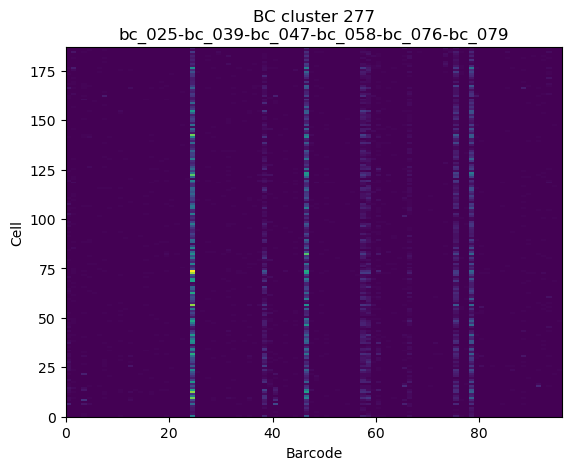

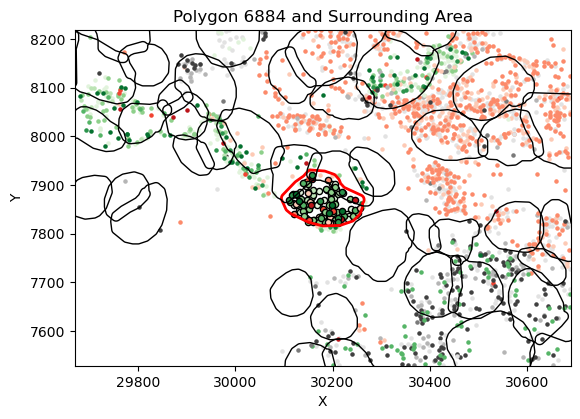

6943
['bc_001', 'bc_002', 'bc_003', 'bc_004', 'bc_005', 'bc_006', 'bc_007', 'bc_008', 'bc_009', 'bc_011', 'bc_012', 'bc_013', 'bc_014', 'bc_015', 'bc_017', 'bc_020', 'bc_021', 'bc_022', 'bc_023', 'bc_024', 'bc_025', 'bc_026', 'bc_027', 'bc_029', 'bc_030', 'bc_031', 'bc_034', 'bc_035', 'bc_036', 'bc_039', 'bc_040', 'bc_041', 'bc_043', 'bc_045', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_052', 'bc_053', 'bc_054', 'bc_055', 'bc_056', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_063', 'bc_064', 'bc_065', 'bc_066', 'bc_067', 'bc_070', 'bc_072', 'bc_073', 'bc_074', 'bc_075', 'bc_076', 'bc_077', 'bc_079', 'bc_080', 'bc_082', 'bc_085', 'bc_087', 'bc_088', 'bc_089', 'bc_091', 'bc_092', 'bc_093', 'bc_094', 'bc_095']
['bc_004', 'bc_025', 'bc_047', 'bc_059', 'bc_076', 'bc_079']
['bc_025', 'bc_039', 'bc_047', 'bc_058', 'bc_076', 'bc_079']
           bc_004  bc_025  bc_039  bc_047  bc_058  bc_059  bc_076  bc_079
object_id                                                           

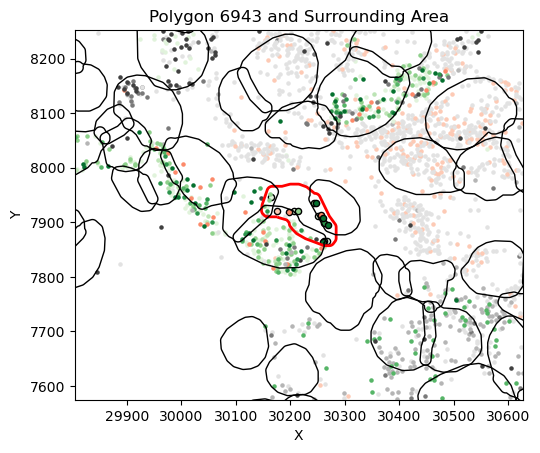

7171
['bc_001', 'bc_002', 'bc_003', 'bc_004', 'bc_005', 'bc_006', 'bc_007', 'bc_008', 'bc_011', 'bc_012', 'bc_013', 'bc_014', 'bc_015', 'bc_019', 'bc_020', 'bc_022', 'bc_024', 'bc_025', 'bc_027', 'bc_030', 'bc_031', 'bc_034', 'bc_035', 'bc_036', 'bc_039', 'bc_040', 'bc_041', 'bc_043', 'bc_045', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_052', 'bc_053', 'bc_054', 'bc_055', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_066', 'bc_067', 'bc_070', 'bc_075', 'bc_076', 'bc_077', 'bc_079', 'bc_085', 'bc_086', 'bc_087', 'bc_088', 'bc_089', 'bc_092', 'bc_094', 'bc_095']
['bc_025', 'bc_039', 'bc_047', 'bc_067', 'bc_079']
['bc_025', 'bc_039', 'bc_047', 'bc_058', 'bc_076', 'bc_079']
           bc_025  bc_039  bc_047  bc_058  bc_067  bc_076  bc_079
object_id                                                        
7171          8.0     1.0     6.0     0.0     2.0     0.0     1.0


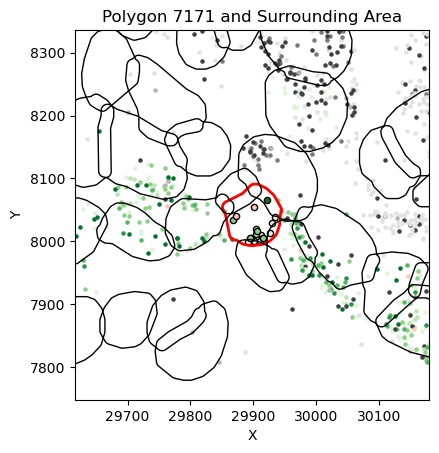

8088
['bc_001', 'bc_002', 'bc_004', 'bc_005', 'bc_006', 'bc_007', 'bc_008', 'bc_009', 'bc_011', 'bc_012', 'bc_013', 'bc_014', 'bc_015', 'bc_016', 'bc_017', 'bc_018', 'bc_019', 'bc_020', 'bc_021', 'bc_022', 'bc_023', 'bc_025', 'bc_026', 'bc_027', 'bc_028', 'bc_029', 'bc_030', 'bc_031', 'bc_032', 'bc_033', 'bc_034', 'bc_035', 'bc_036', 'bc_038', 'bc_039', 'bc_040', 'bc_041', 'bc_042', 'bc_043', 'bc_044', 'bc_045', 'bc_046', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_052', 'bc_053', 'bc_054', 'bc_055', 'bc_056', 'bc_057', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_063', 'bc_064', 'bc_065', 'bc_066', 'bc_067', 'bc_070', 'bc_071', 'bc_072', 'bc_073', 'bc_074', 'bc_075', 'bc_076', 'bc_077', 'bc_078', 'bc_079', 'bc_080', 'bc_081', 'bc_082', 'bc_083', 'bc_084', 'bc_085', 'bc_086', 'bc_087', 'bc_088', 'bc_089', 'bc_090', 'bc_091', 'bc_092', 'bc_093', 'bc_094', 'bc_095', 'bc_096']
['bc_025', 'bc_039', 'bc_047', 'bc_051', 'bc_058', 'bc_059', 'bc_061', 'bc_067', 'bc_076', 'bc

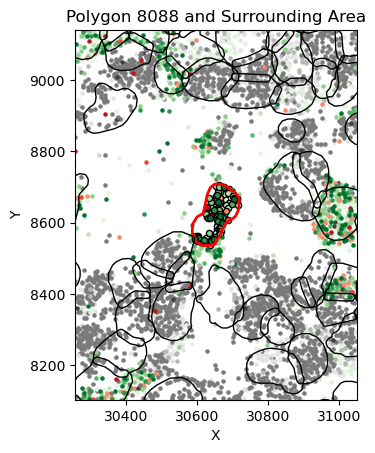

9364
['bc_001', 'bc_002', 'bc_004', 'bc_005', 'bc_006', 'bc_007', 'bc_008', 'bc_009', 'bc_011', 'bc_012', 'bc_013', 'bc_014', 'bc_015', 'bc_016', 'bc_017', 'bc_018', 'bc_019', 'bc_020', 'bc_021', 'bc_022', 'bc_023', 'bc_025', 'bc_026', 'bc_027', 'bc_028', 'bc_029', 'bc_030', 'bc_031', 'bc_032', 'bc_033', 'bc_034', 'bc_035', 'bc_036', 'bc_037', 'bc_038', 'bc_039', 'bc_040', 'bc_041', 'bc_042', 'bc_043', 'bc_045', 'bc_046', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_052', 'bc_053', 'bc_055', 'bc_056', 'bc_057', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_063', 'bc_064', 'bc_065', 'bc_066', 'bc_067', 'bc_071', 'bc_072', 'bc_073', 'bc_074', 'bc_076', 'bc_077', 'bc_078', 'bc_079', 'bc_080', 'bc_081', 'bc_082', 'bc_085', 'bc_087', 'bc_088', 'bc_089', 'bc_090', 'bc_092', 'bc_093', 'bc_094', 'bc_095', 'bc_096']
['bc_001', 'bc_004', 'bc_025', 'bc_039', 'bc_047', 'bc_058', 'bc_059', 'bc_060', 'bc_062', 'bc_066', 'bc_067', 'bc_076', 'bc_079']
['bc_025', 'bc_039', 'bc_047', 'b

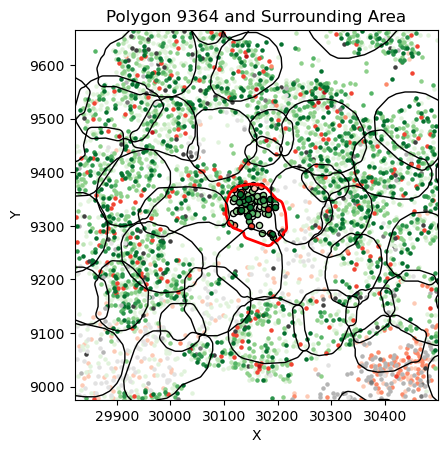

11870
['bc_001', 'bc_002', 'bc_004', 'bc_005', 'bc_006', 'bc_007', 'bc_008', 'bc_009', 'bc_010', 'bc_011', 'bc_012', 'bc_013', 'bc_014', 'bc_015', 'bc_016', 'bc_017', 'bc_018', 'bc_019', 'bc_020', 'bc_021', 'bc_022', 'bc_023', 'bc_024', 'bc_025', 'bc_026', 'bc_028', 'bc_029', 'bc_030', 'bc_031', 'bc_032', 'bc_033', 'bc_034', 'bc_035', 'bc_036', 'bc_037', 'bc_038', 'bc_039', 'bc_040', 'bc_041', 'bc_042', 'bc_043', 'bc_044', 'bc_045', 'bc_046', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_052', 'bc_054', 'bc_055', 'bc_056', 'bc_057', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_063', 'bc_064', 'bc_065', 'bc_066', 'bc_067', 'bc_068', 'bc_069', 'bc_070', 'bc_071', 'bc_072', 'bc_073', 'bc_074', 'bc_075', 'bc_076', 'bc_077', 'bc_078', 'bc_079', 'bc_080', 'bc_081', 'bc_082', 'bc_083', 'bc_084', 'bc_085', 'bc_086', 'bc_087', 'bc_089', 'bc_090', 'bc_091', 'bc_092', 'bc_093', 'bc_094', 'bc_095']
['bc_025', 'bc_039', 'bc_047', 'bc_049', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'b

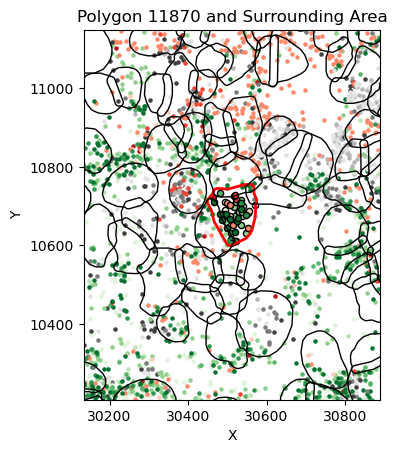

12298
['bc_001', 'bc_002', 'bc_004', 'bc_005', 'bc_007', 'bc_008', 'bc_009', 'bc_010', 'bc_011', 'bc_013', 'bc_015', 'bc_016', 'bc_017', 'bc_019', 'bc_020', 'bc_021', 'bc_022', 'bc_023', 'bc_024', 'bc_025', 'bc_026', 'bc_028', 'bc_029', 'bc_030', 'bc_031', 'bc_032', 'bc_035', 'bc_036', 'bc_037', 'bc_038', 'bc_039', 'bc_040', 'bc_041', 'bc_042', 'bc_043', 'bc_044', 'bc_045', 'bc_046', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_054', 'bc_055', 'bc_056', 'bc_057', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_063', 'bc_064', 'bc_065', 'bc_066', 'bc_067', 'bc_068', 'bc_069', 'bc_070', 'bc_071', 'bc_072', 'bc_074', 'bc_075', 'bc_076', 'bc_077', 'bc_079', 'bc_080', 'bc_082', 'bc_083', 'bc_084', 'bc_087', 'bc_089', 'bc_090', 'bc_091', 'bc_092', 'bc_093', 'bc_094', 'bc_095']
['bc_025', 'bc_028', 'bc_032', 'bc_039', 'bc_047', 'bc_059', 'bc_060', 'bc_061', 'bc_066', 'bc_067', 'bc_074', 'bc_076', 'bc_079', 'bc_091', 'bc_093']
['bc_025', 'bc_039', 'bc_047', 'bc_058', 'bc_076', '

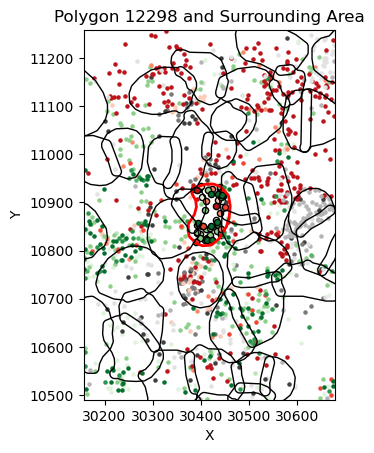

12786
['bc_001', 'bc_002', 'bc_003', 'bc_004', 'bc_005', 'bc_006', 'bc_007', 'bc_008', 'bc_009', 'bc_010', 'bc_011', 'bc_013', 'bc_014', 'bc_015', 'bc_016', 'bc_017', 'bc_018', 'bc_019', 'bc_020', 'bc_021', 'bc_022', 'bc_023', 'bc_024', 'bc_025', 'bc_026', 'bc_028', 'bc_029', 'bc_030', 'bc_031', 'bc_032', 'bc_033', 'bc_034', 'bc_035', 'bc_036', 'bc_037', 'bc_038', 'bc_039', 'bc_040', 'bc_041', 'bc_042', 'bc_043', 'bc_044', 'bc_045', 'bc_046', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_052', 'bc_054', 'bc_055', 'bc_056', 'bc_057', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_063', 'bc_064', 'bc_065', 'bc_066', 'bc_067', 'bc_068', 'bc_069', 'bc_070', 'bc_072', 'bc_074', 'bc_075', 'bc_076', 'bc_077', 'bc_079', 'bc_080', 'bc_081', 'bc_082', 'bc_083', 'bc_084', 'bc_086', 'bc_087', 'bc_089', 'bc_090', 'bc_091', 'bc_092', 'bc_093', 'bc_094', 'bc_095', 'bc_096']
['bc_005', 'bc_008', 'bc_025', 'bc_047', 'bc_058', 'bc_074', 'bc_075', 'bc_076', 'bc_079']
['bc_025', 'bc_039', '

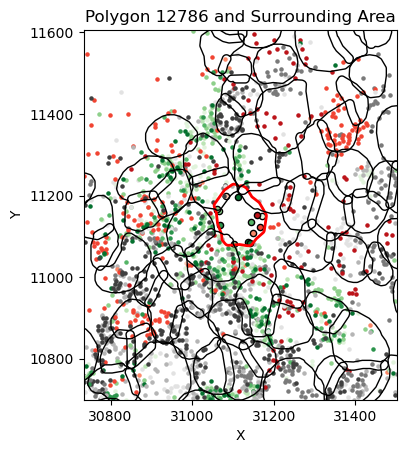

12920
['bc_001', 'bc_002', 'bc_003', 'bc_004', 'bc_005', 'bc_006', 'bc_007', 'bc_008', 'bc_009', 'bc_010', 'bc_011', 'bc_013', 'bc_014', 'bc_015', 'bc_016', 'bc_018', 'bc_019', 'bc_020', 'bc_021', 'bc_022', 'bc_023', 'bc_024', 'bc_025', 'bc_026', 'bc_028', 'bc_029', 'bc_030', 'bc_031', 'bc_032', 'bc_033', 'bc_034', 'bc_035', 'bc_036', 'bc_037', 'bc_038', 'bc_039', 'bc_040', 'bc_041', 'bc_042', 'bc_043', 'bc_044', 'bc_045', 'bc_046', 'bc_047', 'bc_048', 'bc_049', 'bc_050', 'bc_051', 'bc_052', 'bc_054', 'bc_055', 'bc_056', 'bc_057', 'bc_058', 'bc_059', 'bc_060', 'bc_061', 'bc_062', 'bc_063', 'bc_064', 'bc_065', 'bc_066', 'bc_067', 'bc_068', 'bc_069', 'bc_070', 'bc_071', 'bc_072', 'bc_074', 'bc_075', 'bc_076', 'bc_077', 'bc_079', 'bc_080', 'bc_081', 'bc_082', 'bc_083', 'bc_084', 'bc_086', 'bc_087', 'bc_089', 'bc_090', 'bc_091', 'bc_093', 'bc_094', 'bc_095', 'bc_096']
['bc_025', 'bc_047', 'bc_049', 'bc_058', 'bc_066', 'bc_067', 'bc_074', 'bc_076', 'bc_079', 'bc_084', 'bc_094']
['bc_025', '

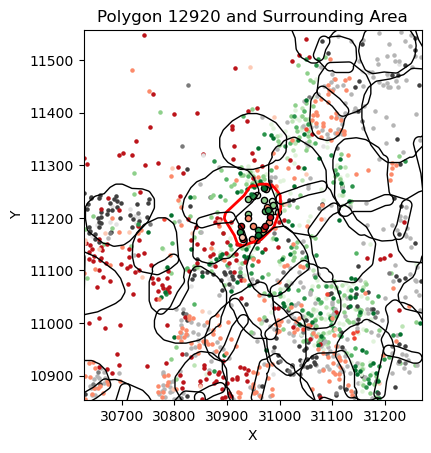

In [127]:

cluster_of_interest = 277
# cluster_of_interest = 22
# cluster_of_interest = 184
cell_ids = adata_genes[adata_genes.obs['bc_cluster']==cluster_of_interest ].obs['cell_id'].values

# genes_here= tools.get_barcodes_within_polygonlist(df,cell_ids)
plt.figure()
plt.title(f'BC cluster {cluster_of_interest}\n{cluster_barcode_names[cluster_of_interest]}')
plt.pcolormesh(df[df['cell_id'].isin(cell_ids)][barcode_cols].values)
plt.ylabel('Cell')
plt.xlabel('Barcode')


for cell_id in cell_ids[[0,1,5,10,40,-10,-5,-2,-1]]:
# for cell_id in cell_ids[:4]:

    print(cell_id)
    # print(df[df['cell_id']==cell_id]['area'].values[0])
    # print(df[df['cell_id']==cell_id][barcode_cols].values[0]))

    region = get_polygons_around_polygon(sg_obj,cell_id,image_scale=10)



    # gene_names = get_all_barcodes_in_region(df,region['object_id'].values)
    gene_names = tools.get_barcodes_within_polygonlist(df,region['object_id'].values)
    gene_names = sorted(np.unique(gene_names))
 
    object_genes = tools.get_barcodes_within_polygon(df,cell_id)
    # df[df['cell_id']=='28744'][]
    print(gene_names)
    print(object_genes)

    # true_genes = ['bc_001','bc_029','bc_031','bc_087']
    true_genes = cluster_found_barcodes[cluster_of_interest]
    print(true_genes)

    print(df[df['cell_id']==cell_id][sorted(np.unique(object_genes+true_genes))])

    # print(df[df['cell_id']==cell_id][gene_names])


    c_map = {gene:sns.color_palette('Greens',len(true_genes))[i] for i,gene in enumerate(true_genes)}
    
    g0 = 0
    g1 = 0
    g2 = 0
    for g,gene in enumerate(gene_names):
        if gene not in true_genes:
            if gene not in object_genes:
                c_map[gene] = sns.color_palette('Greys',4)[g1%4]
                g1 += 1
            else:
                c_map[gene] = sns.color_palette('Reds',4)[g2%4]
                g2 += 1
        else:
            c_map[gene] = sns.color_palette('Greens',len(true_genes))[g0%len(true_genes)]
            g0 += 1

    # sg_obj.plot_polygon_and_points(cell_id,gene_names=gene_names,annotate=False,image_scale=5)
    tools.plot_polygon_and_points(sg_obj,cell_id,gene_names=gene_names,annotate=False,image_scale=5,
                                  interior_marker='o',exterior_marker='.',marker_size=20,color_map=c_map,
                                  )
    # sg_obj_only_bcs.plot_polygon_and_points(mapping_dict[cell_id],gene_names=gene_names,annotate=False)

In [58]:
cell_ids[[0,1,10,-2,-1]]

array(['15863', '16177', '16783', '24084', '24120'], dtype=object)

In [89]:
def get_barcodes_within_polygon(df,identifier,id_field='cell_id',barcode_cols=[f'bc_{i:03}' for i in range(1,97)]):

    this_polygon = df[df[id_field]==identifier]
    m2 = (this_polygon[barcode_cols] > 0).any()
    a = m2.index[m2].tolist()
    return a 

In [90]:
get_barcodes_within_polygon(df,'28744')

['bc_001',
 'bc_004',
 'bc_022',
 'bc_024',
 'bc_029',
 'bc_030',
 'bc_031',
 'bc_041',
 'bc_048',
 'bc_056',
 'bc_077',
 'bc_087']

,bc_001,bc_004,bc_022,bc_024,bc_029,bc_030,bc_031,bc_041,bc_048,bc_056,bc_077,bc_087
object_id,,,,,,,,,,,,
28744,8.0,1.0,1.0,1.0,4.0,1.0,11.0,2.0,3.0,4.0,1.0,16.0


In [106]:
scipy.spatial.distance.braycurtis([22,18,0],[34,16,41])

0.4198473282442748

In [107]:
scipy.spatial.distance.braycurtis([22,18,0]/np.sum([22,18,0]),[34,16,41]/np.sum([34,16,41]))

0.4505494505494506

In [108]:
scipy.spatial.distance.jaccard([22,18,0],[34,16,41])

1.0